# Vehicle Detection on Low Light Condition using YOLO v8
Dataset: https://www.kaggle.com/datasets/saralajew/provident-vehicle-detection-at-night-pvdn <br>
Model Used: YOLO v8 nano <br>
Kelompok:
1. Muhammad Nadine Zuhdan Azra (1301210534)
2. Agustinus David (1301213504)
3. Fathan Askar (1301213374)

### Input the downloaded data from Kaggle and change the structure of the labels into YOLOv8 Format

In [2]:
import os
import shutil
import json

#Get all images from the directory of the saved dataset
def get_all_images(images_base_dirs):
    image_files = []
    for images_base_dir in images_base_dirs:
        for root, _, files in os.walk(images_base_dir):
            for file in files:
                if file.endswith('.png'):
                    image_files.append(os.path.join(root, file))
    return image_files

#Create dataset based on YOLOv8's structure (80% train, 10% val, 10% test)
def create_yolo_dataset_structure(image_files, labels_base_dirs, output_dir, image_size=(1280, 960)):
    images_output_dir = os.path.join(output_dir, 'images')
    labels_output_dir = os.path.join(output_dir, 'labels')
    for subdir in ['train', 'val', 'test']:
        os.makedirs(os.path.join(images_output_dir, subdir), exist_ok=True)
        os.makedirs(os.path.join(labels_output_dir, subdir), exist_ok=True)

    print(f"Total images available: {len(image_files)}. Using all files.")

    #Split data into 80:10:10 (train, val, and test)
    train_split = int(0.8 * len(image_files))
    val_split = int(0.9 * len(image_files))
    train_files = image_files[:train_split]
    val_files = image_files[train_split:val_split]
    test_files = image_files[val_split:]

    #Convert into  YOLOv8's Structure
    for files, subdir in [(train_files, 'train'), (val_files, 'val'), (test_files, 'test')]:
        for image_path in files:
            image_name = os.path.basename(image_path)
            label_found = False
            for labels_base_dir in labels_base_dirs:
                src_label = os.path.join(labels_base_dir, image_name.replace('.png', '.json'))
                if os.path.exists(src_label):
                    label_found = True
                    break
            dst_image = os.path.join(images_output_dir, subdir, image_name)
            dst_label = os.path.join(labels_output_dir, subdir, image_name.replace('.png', '.txt'))
            if os.path.exists(image_path):
                shutil.copy(image_path, dst_image)
                print(f"Copied image: {image_path} -> {dst_image}")
            if label_found:
                with open(src_label, 'r') as f:
                    annotation_data = json.load(f)
                yolo_annotations = []
                for annotation in annotation_data.get('annotations', []):
                    for instance in annotation.get('instances', []):
                        x_center, y_center = instance['pos']
                        width, height = 50, 50
                        x_center /= image_size[0]
                        y_center /= image_size[1]
                        width /= image_size[0]
                        height /= image_size[1]
                        class_id = 0 if instance['direct'] else 1
                        yolo_annotations.append(f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}")

                #Save YOLO formatted labels
                with open(dst_label, 'w') as f:
                    f.write('\n'.join(yolo_annotations))
                print(f"Created label: {dst_label}")
            else:
                print(f"Label not found for image: {image_name}")

dataset_path = 'D:\\PVDN\\PVDN\\night'
splits = ['train', 'val', 'test']
image_dirs = [os.path.join(dataset_path, split, 'images') for split in splits]
label_dirs = [os.path.join(dataset_path, split, 'labels', 'keypoints') for split in splits]
all_images = get_all_images(image_dirs)
create_yolo_dataset_structure(image_files=all_images, labels_base_dirs=label_dirs, output_dir='all_data_dataset')

Total images available: 33638. Using all files.
Copied image: D:\PVDN\PVDN\night\train\images\S00000\000001.png -> all_data_dataset\images\train\000001.png
Created label: all_data_dataset\labels\train\000001.txt
Copied image: D:\PVDN\PVDN\night\train\images\S00000\000003.png -> all_data_dataset\images\train\000003.png
Created label: all_data_dataset\labels\train\000003.txt
Copied image: D:\PVDN\PVDN\night\train\images\S00000\000005.png -> all_data_dataset\images\train\000005.png
Created label: all_data_dataset\labels\train\000005.txt
Copied image: D:\PVDN\PVDN\night\train\images\S00000\000007.png -> all_data_dataset\images\train\000007.png
Created label: all_data_dataset\labels\train\000007.txt
Copied image: D:\PVDN\PVDN\night\train\images\S00000\000009.png -> all_data_dataset\images\train\000009.png
Created label: all_data_dataset\labels\train\000009.txt
Copied image: D:\PVDN\PVDN\night\train\images\S00000\000011.png -> all_data_dataset\images\train\000011.png
Created label: all_data_

In [4]:
#Checking the train, validation, test split
def count_files_in_directory(base_dir):
    splits = ['train', 'val', 'test']
    for split in splits:
        images_dir = os.path.join(base_dir, 'images', split)
        labels_dir = os.path.join(base_dir, 'labels', split)
        image_count = sum([len(files) for _, _, files in os.walk(images_dir) if files])
        label_count = sum([len(files) for _, _, files in os.walk(labels_dir) if files])
        print(f"{split.capitalize()} - Images: {image_count}, Labels: {label_count}")

count_files_in_directory('all_data_dataset')
#count_files_in_directory('data2k')
#count_files_in_directory('data5k')
#count_files_in_directory('data10k')


Train - Images: 26910, Labels: 26910
Val - Images: 3364, Labels: 3364
Test - Images: 3364, Labels: 3364


### Preprocessing the data

In [1]:
#FATHANS PREPROCESSING
import cv2
import os
import numpy as np
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm

#Apply CLAHE, Gamma Correction, and Normalization (best so far from trying out different preprocessings)
def preprocess_image(input_path, output_path):
    def apply_clahe(img):
        lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
        l = clahe.apply(l)
        lab = cv2.merge((l, a, b))
        return cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
    def gamma_correction(img, gamma=1.5):
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in np.arange(0, 256)]).astype("uint8")
        return cv2.LUT(img, table)
    def normalize_image(img):
        img = img / 255.0
        return (img * 255).astype(np.uint8)
    img = cv2.imread(input_path)
    if img is None:
        return
    img = apply_clahe(img)
    img = gamma_correction(img)
    img = normalize_image(img)
    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    cv2.imwrite(output_path, img)

def preprocess_low_light_images(base_input_dir, base_output_dir):
    image_paths = []
    for subdir in ['train', 'val', 'test']:
        input_dir = os.path.join(base_input_dir, subdir)
        output_dir = os.path.join(base_output_dir, subdir)
        os.makedirs(output_dir, exist_ok=True)
        for root, _, files in os.walk(input_dir):
            for file in files:
                if file.endswith(('.png', '.jpg', '.jpeg')):
                    input_path = os.path.join(root, file)
                    relative_path = os.path.relpath(input_path, input_dir)
                    output_path = os.path.join(output_dir, relative_path)
                    image_paths.append((input_path, output_path))
    #For progress bar (usning tqdm)
    with ThreadPoolExecutor() as executor:
        list(tqdm(executor.map(lambda paths: preprocess_image(*paths), image_paths), total=len(image_paths)))

    print(f"Preprocessed images saved in: {base_output_dir}")

preprocess_low_light_images('all_data_dataset/images', 'preprocessed_data_Fathan/images')

# #NADNIES PREPROCESSING (UNUSED AT THE END)
# from PIL import Image, ImageEnhance, ImageFilter
# import numpy as np
# import os
# from concurrent.futures import ThreadPoolExecutor
# from tqdm import tqdm

# def bright_cont_med(img, contrast_mag=3, brightness_mag=0.1, filter_size=7):
#     enhancer = ImageEnhance.Brightness(img)
#     img_post_bright = enhancer.enhance(brightness_mag)
#     enhancer = ImageEnhance.Contrast(img_post_bright)
#     img_bright_contrast = enhancer.enhance(contrast_mag)

#     img_med_filter = img_bright_contrast.filter(ImageFilter.MedianFilter(size=filter_size))

#     img_array = np.asarray(img_med_filter)

#     max_val = np.max(img_array)
#     min_val = np.min(img_array)

#     img_array = ((img_array - min_val) / (max_val - min_val)) * 200
#     img_array = img_array + 55
#     img_pp = Image.fromarray(img_array.astype(np.int32)).convert('L')

#     return img_pp

# def preprocess_image(input_path, output_path):
#     img = Image.open(input_path)
#     img = bright_cont_med(img)

#     os.makedirs(os.path.dirname(output_path), exist_ok=True)
#     img.save(output_path)

# def preprocess_low_light_images(base_input_dir, base_output_dir):
#     image_paths = []
#     for subdir in ['train', 'val', 'test']:
#         input_dir = os.path.join(base_input_dir, subdir)
#         output_dir = os.path.join(base_output_dir, subdir)
#         os.makedirs(output_dir, exist_ok=True)

#         for root, _, files in os.walk(input_dir):
#             for file in files:
#                 if file.endswith(('.png', '.jpg', '.jpeg')):
#                     input_path = os.path.join(root, file)
#                     relative_path = os.path.relpath(input_path, input_dir)
#                     output_path = os.path.join(output_dir, relative_path)
#                     image_paths.append((input_path, output_path))

#     with ThreadPoolExecutor() as executor:
#         list(tqdm(executor.map(lambda paths: preprocess_image(*paths), image_paths), total=len(image_paths)))

#     print(f"Preprocessed images saved in: {base_output_dir}")

100%|██████████| 33638/33638 [14:31<00:00, 38.58it/s]

Preprocessed images saved in: preprocessed_data_Fathan/images


### Training on 2k, 5k and 10k data (To try out different preprocessing methods)

In [ ]:
from ultralytics import YOLO
#10K Fathan preprocessing 1
#Load a YOLOv8 model
model = YOLO('yolov8n.pt')  #Use yolov8n.pt because it is a lightweight model

#Train the model
model.train(
    data='data.yaml', 
    epochs=20,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='preprocessed_training', 
)

New https://pypi.org/project/ultralytics/8.3.32 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=preprocessed_training4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, e

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data10k\labels\train.cache... 8000 images, 2363 backgrounds, 0 corrupt: 100%|██████████| 8000/8000 [00:00<?, ?it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data10k\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data10k\images\train\004553.png: 1 duplicate labels removed



val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data10k\labels\val.cache... 1000 images, 315 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<?, ?it/s]


Plotting labels to vehicle_detection\preprocessed_training4\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\preprocessed_training4
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.21G      2.121      2.823      1.173         46        640: 100%|██████████| 500/500 [01:58<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.45it/s]


                   all       1000       2700      0.643      0.513      0.586      0.299

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.24G       1.56       1.59     0.9768        103        640: 100%|██████████| 500/500 [01:53<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.30it/s]

                   all       1000       2700      0.707      0.525      0.611       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.21G      1.473      1.442     0.9596         92        640: 100%|██████████| 500/500 [01:53<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.52it/s]


                   all       1000       2700      0.707      0.515      0.612      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.24G      1.364      1.356     0.9358         73        640: 100%|██████████| 500/500 [01:54<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.48it/s]

                   all       1000       2700      0.734      0.566      0.679      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.22G      1.302      1.274     0.9199         61        640: 100%|██████████| 500/500 [01:55<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.48it/s]


                   all       1000       2700       0.76      0.589      0.698      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.19G      1.245      1.226     0.9118         69        640: 100%|██████████| 500/500 [01:56<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.52it/s]

                   all       1000       2700      0.747      0.599        0.7      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.33G      1.215      1.174     0.9043         75        640: 100%|██████████| 500/500 [01:55<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.48it/s]

                   all       1000       2700      0.768      0.615      0.724      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.18G       1.19      1.153     0.8981         68        640: 100%|██████████| 500/500 [01:55<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.49it/s]


                   all       1000       2700      0.759      0.637      0.733      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.22G      1.175      1.128     0.8968        138        640: 100%|██████████| 500/500 [01:55<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.51it/s]

                   all       1000       2700      0.737      0.623      0.715      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.26G      1.133      1.094     0.8889         81        640: 100%|██████████| 500/500 [01:55<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.35it/s]

                   all       1000       2700      0.767      0.651      0.743      0.558


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20       2.2G      1.054      1.033     0.8948         32        640: 100%|██████████| 500/500 [01:52<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.53it/s]

                   all       1000       2700      0.772      0.642      0.747      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.16G      1.016      1.012     0.8871         49        640: 100%|██████████| 500/500 [01:53<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:08<00:00,  3.56it/s]

                   all       1000       2700      0.781      0.666      0.761      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.16G     0.9759      0.974      0.883         39        640: 100%|██████████| 500/500 [01:54<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.43it/s]

                   all       1000       2700      0.779      0.658      0.757      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.18G     0.9433      0.947     0.8756         70        640: 100%|██████████| 500/500 [01:54<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.50it/s]

                   all       1000       2700      0.794       0.65      0.765      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.16G     0.9386     0.9324     0.8718         40        640: 100%|██████████| 500/500 [01:53<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.51it/s]

                   all       1000       2700      0.774      0.666      0.761      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.17G     0.9134        0.9     0.8677         54        640: 100%|██████████| 500/500 [01:54<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.48it/s]

                   all       1000       2700      0.812      0.669      0.772      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.16G     0.9106     0.8767     0.8692         31        640: 100%|██████████| 500/500 [01:53<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.22it/s]

                   all       1000       2700      0.803      0.663      0.773      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.22G     0.8833     0.8575     0.8615         47        640: 100%|██████████| 500/500 [01:54<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.53it/s]

                   all       1000       2700      0.821      0.657      0.772      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.17G     0.8675     0.8352     0.8598         64        640: 100%|██████████| 500/500 [01:54<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.52it/s]

                   all       1000       2700      0.822      0.675      0.788      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.18G     0.8531     0.8173     0.8605         27        640: 100%|██████████| 500/500 [01:55<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.29it/s]

                   all       1000       2700      0.806      0.691      0.792      0.629



20 epochs completed in 0.704 hours.
Optimizer stripped from vehicle_detection\preprocessed_training4\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\preprocessed_training4\weights\best.pt, 6.2MB

Validating vehicle_detection\preprocessed_training4\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:10<00:00,  3.04it/s]


                   all       1000       2700      0.804       0.69      0.792      0.629
               vehicle        528       1532      0.864      0.792      0.875      0.742
        light_instance        553       1168      0.744      0.589       0.71      0.515
Speed: 0.3ms preprocess, 2.3ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to vehicle_detection\preprocessed_training4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000235DD2B8790>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0


image 1/1 D:\Random_Projects\Tubes Viskom\preprocessed_data\images\test\020365.png: 480x640 2 vehicles, 2 light_instances, 25.3ms
Speed: 4.0ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Original Image:


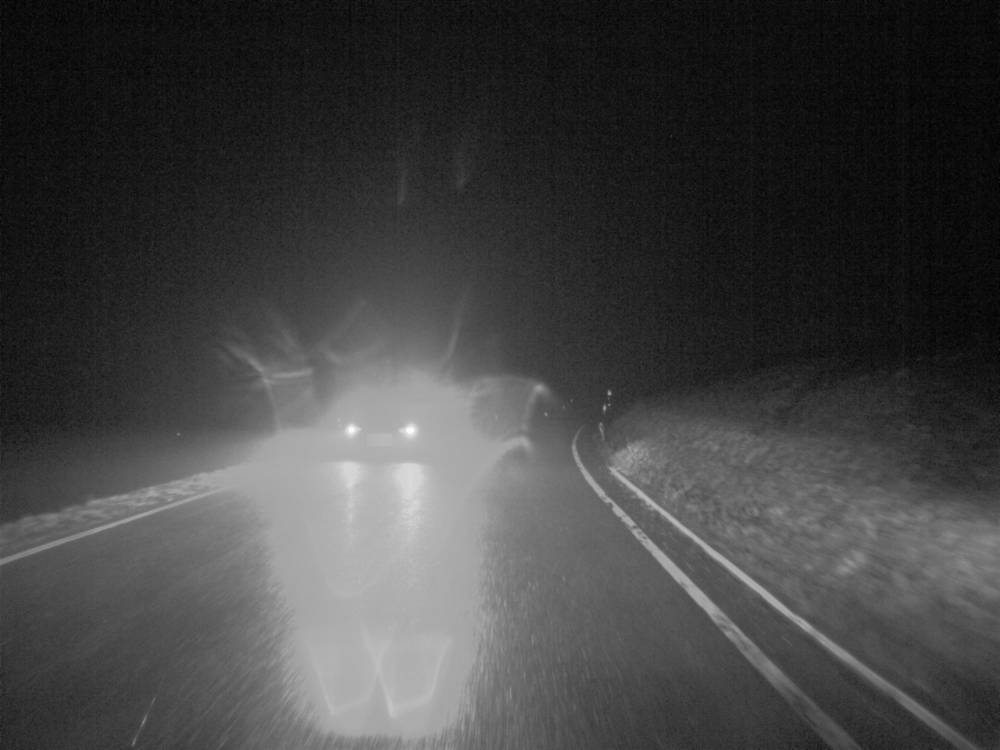

Object Detection Result:


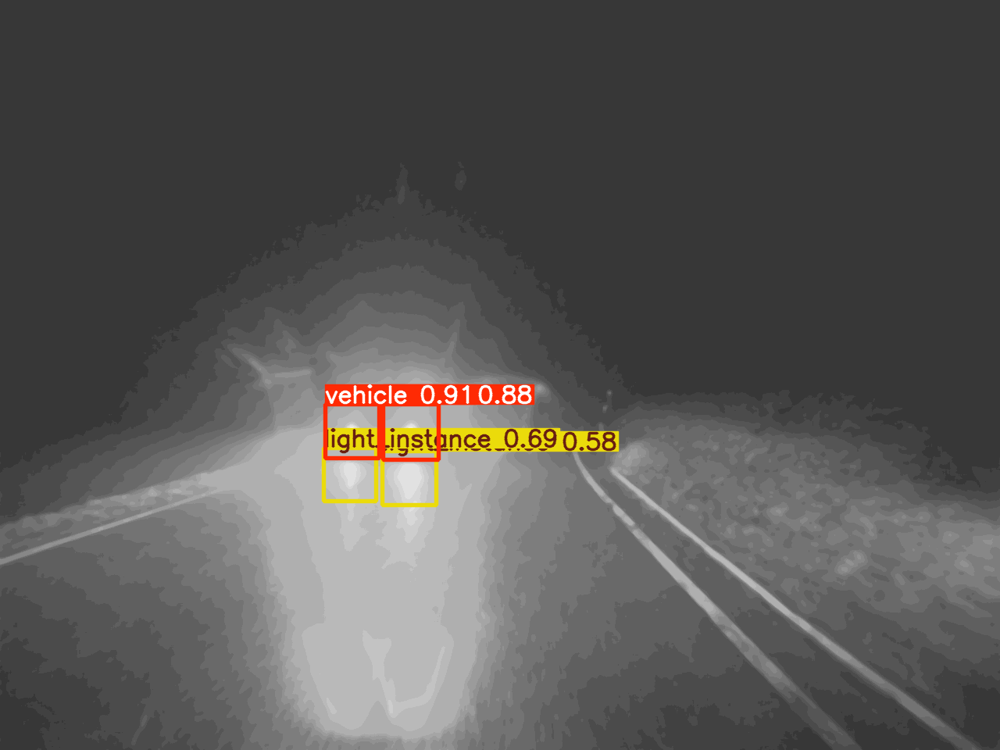

In [18]:
from ultralytics import YOLO
from IPython.display import display
from PIL import Image
import cv2

#Testing out an image from test dataset
#Load the trained model with the best weights
model = YOLO('D:/Random_Projects/Tubes Viskom/vehicle_detection/preprocessed_training4/weights/best.pt')

#Paths to the original and preprocessed test images
original_image_path = 'D:\\Random_Projects\\Tubes Viskom\\all_data_dataset\\images\\test\\020365.png'
preprocessed_image_path = 'D:\\Random_Projects\\Tubes Viskom\\preprocessed_data\\images\\test\\020365.png'
results = model(preprocessed_image_path)#Test the test image

#Original Image
original_image = cv2.imread(original_image_path)
print("Original Image:")
display(Image.fromarray(original_image))

#Object detected image
for result in results:
    result_image = result.plot()
    print("Object Detection Result:")
    display(Image.fromarray(result_image))


In [ ]:
preprocess_low_light_images('data2k/images', 'preprocessed_data2k/images')

100%|██████████| 2000/2000 [00:47<00:00, 42.42it/s]

Preprocessed images saved in: preprocessed_data2k/images


In [2]:
# from ultralytics import YOLO
# #2k Fathan Preprocessing 2
# #Load a YOLOv8 model
# model = YOLO('yolov8n.pt')

# #Train the model
# model.train(
#     data='data2k.yaml', 
#     epochs=20,
#     imgsz=640,  
#     batch=16,
#     project='vehicle_detection', 
#     name='preprocessed_training', 
# )


In [ ]:
from ultralytics import YOLO
#10k Nadine's preprocessing
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='data10kNadine.yaml', 
    epochs=20,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='preprocessed_training',
)

New https://pypi.org/project/ultralytics/8.3.51 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=data10kNadine.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=preprocessed_training8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data10kNadine\labels\train... 8000 images, 2363 backgrounds, 0 corrupt: 100%|██████████| 8000/8000 [00:08<00:00, 917.90it/s] 

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data10kNadine\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data10kNadine\images\train\004553.png: 1 duplicate labels removed


train: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data10kNadine\labels\train.cache


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data10kNadine\labels\val... 1000 images, 315 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:02<00:00, 472.96it/s]


val: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data10kNadine\labels\val.cache
Plotting labels to vehicle_detection\preprocessed_training8\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\preprocessed_training8
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.25G      1.972       2.59      1.131         46        640: 100%|██████████| 500/500 [01:55<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.02it/s]


                   all       1000       2700      0.719      0.512      0.606      0.402

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.24G      1.433      1.463     0.9508        103        640: 100%|██████████| 500/500 [01:49<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:08<00:00,  3.83it/s]

                   all       1000       2700      0.359      0.597      0.338      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.21G      1.379      1.348     0.9413         92        640: 100%|██████████| 500/500 [01:47<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.24it/s]

                   all       1000       2700      0.758      0.565      0.665      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.25G      1.268      1.242     0.9194         73        640: 100%|██████████| 500/500 [01:45<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.19it/s]

                   all       1000       2700      0.755      0.589      0.694      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.22G      1.184      1.177     0.8991         61        640: 100%|██████████| 500/500 [01:47<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:08<00:00,  3.73it/s]

                   all       1000       2700      0.733        0.6        0.7      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20       2.2G      1.125       1.11     0.8914         69        640: 100%|██████████| 500/500 [01:46<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.19it/s]

                   all       1000       2700      0.788       0.61      0.712      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.33G      1.102      1.066     0.8873         75        640: 100%|██████████| 500/500 [01:46<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:08<00:00,  4.00it/s]

                   all       1000       2700      0.751      0.609      0.709      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.19G      1.066      1.062     0.8783         68        640: 100%|██████████| 500/500 [01:46<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.13it/s]

                   all       1000       2700       0.77      0.629      0.728      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.22G      1.043      1.018      0.875        138        640: 100%|██████████| 500/500 [01:46<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.19it/s]

                   all       1000       2700      0.775      0.618       0.73      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.26G      1.008     0.9858     0.8699         81        640: 100%|██████████| 500/500 [01:47<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.27it/s]

                   all       1000       2700      0.788      0.632      0.734      0.562


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20       2.2G     0.9121     0.9336     0.8703         32        640: 100%|██████████| 500/500 [01:44<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.20it/s]

                   all       1000       2700      0.775      0.624      0.727      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.16G     0.8808     0.9174      0.865         49        640: 100%|██████████| 500/500 [01:44<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.30it/s]

                   all       1000       2700      0.824      0.625      0.749      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.16G     0.8618     0.8762     0.8622         39        640: 100%|██████████| 500/500 [01:44<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.25it/s]

                   all       1000       2700      0.826      0.646      0.759      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.18G     0.8395       0.85     0.8577         70        640: 100%|██████████| 500/500 [01:44<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.24it/s]

                   all       1000       2700        0.8       0.65       0.76      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.16G     0.8275     0.8288     0.8537         40        640: 100%|██████████| 500/500 [01:44<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.21it/s]

                   all       1000       2700      0.802      0.679      0.772      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.17G     0.8051     0.7992     0.8502         54        640: 100%|██████████| 500/500 [01:45<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.26it/s]

                   all       1000       2700       0.83      0.669      0.779      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.16G     0.7893     0.7752     0.8495         31        640: 100%|██████████| 500/500 [01:45<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.26it/s]

                   all       1000       2700      0.847      0.665      0.781      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.22G      0.776     0.7604     0.8458         47        640: 100%|██████████| 500/500 [01:45<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.29it/s]

                   all       1000       2700      0.841      0.676      0.785      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.17G     0.7621     0.7353      0.844         64        640: 100%|██████████| 500/500 [01:45<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.29it/s]

                   all       1000       2700      0.845      0.672      0.792      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.19G     0.7484     0.7229     0.8444         27        640: 100%|██████████| 500/500 [01:45<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:07<00:00,  4.22it/s]

                   all       1000       2700      0.826      0.689      0.796      0.639



20 epochs completed in 0.649 hours.
Optimizer stripped from vehicle_detection\preprocessed_training8\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\preprocessed_training8\weights\best.pt, 6.2MB

Validating vehicle_detection\preprocessed_training8\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:08<00:00,  3.91it/s]


                   all       1000       2700      0.829      0.688      0.795      0.639
               vehicle        528       1532      0.885      0.783      0.861      0.743
        light_instance        553       1168      0.772      0.592       0.73      0.534
Speed: 0.3ms preprocess, 2.0ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to vehicle_detection\preprocessed_training8


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001A8C6771270>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

### Hyperparameter Tuning on all the data (33638 Night data thats been through the Nadine's Preprocessing)

In [6]:
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allData.yaml',
    epochs=20,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='full_data_training',
)

New https://pypi.org/project/ultralytics/8.3.51 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allData.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, em

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\train... 26910 images, 7450 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [00:51<00:00, 521.75it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004455.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004457.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004459.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004461.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004465.png: 4 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004467.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004469.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preproce

train: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\train.cache


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\val... 3364 images, 1147 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:07<00:00, 444.36it/s]


val: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\val.cache
Plotting labels to vehicle_detection\full_data_training\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.39G      1.607      1.945      1.017         46        640: 100%|██████████| 1682/1682 [06:19<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.19it/s]


                   all       3364       8363       0.81       0.62       0.74      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.45G      1.189      1.178     0.8994         84        640: 100%|██████████| 1682/1682 [06:05<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.00it/s]


                   all       3364       8363      0.876      0.636      0.776      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.22G      1.108      1.079     0.8842         73        640: 100%|██████████| 1682/1682 [06:03<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.14it/s]


                   all       3364       8363      0.885      0.617      0.744      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20       2.2G      1.044      1.008     0.8729         71        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.27it/s]

                   all       3364       8363      0.859      0.675      0.789      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.32G     0.9853     0.9436     0.8632        103        640: 100%|██████████| 1682/1682 [05:59<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.19it/s]

                   all       3364       8363      0.851      0.697      0.802      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20       2.3G     0.9499     0.8967     0.8582         57        640: 100%|██████████| 1682/1682 [05:59<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.18it/s]

                   all       3364       8363      0.863      0.699      0.807      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.32G     0.9197     0.8581     0.8519         69        640: 100%|██████████| 1682/1682 [05:58<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.19it/s]

                   all       3364       8363      0.868      0.706      0.813      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.33G     0.8975     0.8226     0.8493         50        640: 100%|██████████| 1682/1682 [06:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.17it/s]


                   all       3364       8363      0.849      0.714      0.812      0.662

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.23G     0.8719     0.7929     0.8458         96        640: 100%|██████████| 1682/1682 [06:00<00:00,  4.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.16it/s]

                   all       3364       8363      0.854      0.729      0.823       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20       2.4G     0.8555     0.7722     0.8419         73        640: 100%|██████████| 1682/1682 [06:02<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.06it/s]

                   all       3364       8363      0.855      0.725      0.817      0.674


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20       2.2G     0.7703     0.7182     0.8428         44        640: 100%|██████████| 1682/1682 [05:58<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.27it/s]

                   all       3364       8363      0.844       0.73      0.819      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.23G     0.7534     0.6972     0.8399         38        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.17it/s]

                   all       3364       8363      0.856      0.714      0.812      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20       2.2G     0.7421     0.6737     0.8365         50        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.18it/s]

                   all       3364       8363      0.847      0.736       0.82      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.18G     0.7243     0.6519     0.8345         72        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.14it/s]

                   all       3364       8363      0.864      0.716      0.812      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.23G     0.7166     0.6345     0.8321         63        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.09it/s]

                   all       3364       8363      0.862      0.729      0.819      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20       2.2G     0.7076       0.62     0.8314         36        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  3.96it/s]

                   all       3364       8363       0.86      0.724      0.814      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20       2.2G     0.6923     0.6039     0.8293         35        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.07it/s]

                   all       3364       8363      0.848      0.731      0.815      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20       2.2G     0.6816     0.5829     0.8277         38        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.07it/s]

                   all       3364       8363      0.846       0.73      0.811      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.18G     0.6681     0.5722     0.8251         28        640: 100%|██████████| 1682/1682 [05:58<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.17it/s]

                   all       3364       8363      0.868      0.719       0.81      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20       2.2G     0.6594     0.5563     0.8254         37        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.12it/s]

                   all       3364       8363      0.869      0.719      0.807      0.675



20 epochs completed in 2.169 hours.
Optimizer stripped from vehicle_detection\full_data_training\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.76it/s]


                   all       3364       8363      0.865      0.729      0.819      0.682
               vehicle       1855       4070      0.931      0.876      0.925      0.839
        light_instance       1929       4293      0.799      0.581      0.714      0.525
Speed: 0.3ms preprocess, 2.1ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to vehicle_detection\full_data_training


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001A8EA9DF520>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   408.476         1.60707         1.94503         1.01710   
1      2   842.862         1.18915         1.17824         0.89941   
2      3  1232.830         1.10770         1.07864         0.88424   
3      4  1615.160         1.04393         1.00829         0.87294   
4      5  2000.290         0.98529         0.94361         0.86318   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.80952            0.62017           0.73953   
1               0.87561            0.63637           0.77632   
2               0.88458            0.61702           0.74445   
3               0.85919            0.67490           0.78935   
4               0.85097            0.69722           0.80206   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.53603       1.06471       1.72866       0.85761  0.000555   
1              0.59252       0.89565  

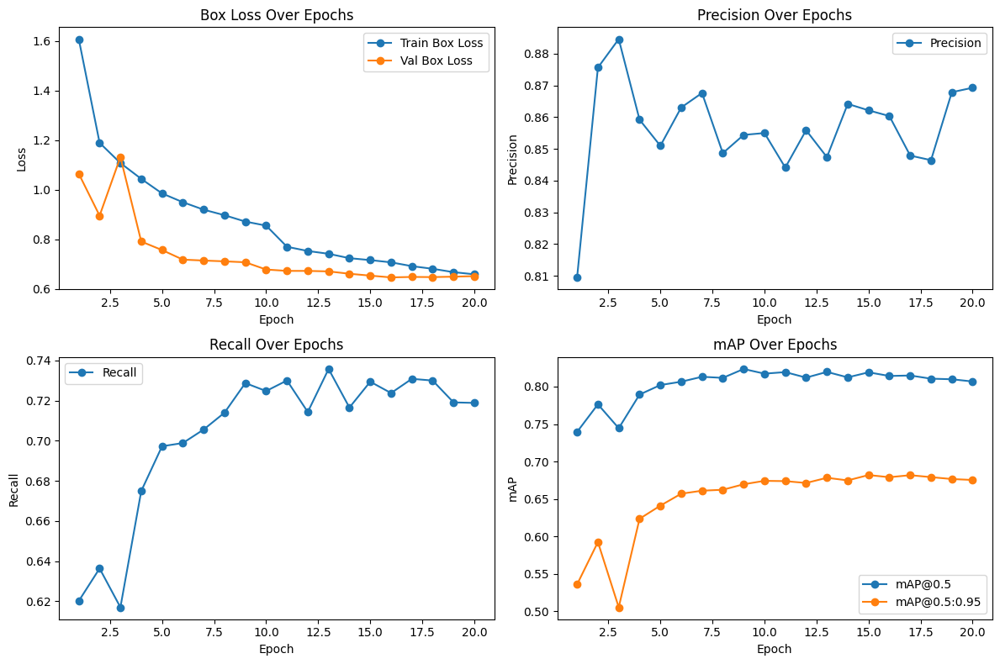

In [4]:
#Plot metrics graph to monitor the training process and evaluate the model's overall performance (Train Loss, Val Loss, Precision, Recall, mAP@50, and mAP@50:95)
import pandas as pd
import matplotlib.pyplot as plt

#Path to results.csv file
results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training/results.csv'

#Load the results CSV file
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()


In [1]:
#Try higher learning rate, augmentation, and use cosnie learning rate
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allData.yaml',
    epochs=20,
    imgsz=640,
    batch=16,
    project='vehicle_detection', 
    name='full_data_training3',
    augment=True,
    cos_lr=True,
    lr0=0.01667
)

New https://pypi.org/project/ultralytics/8.3.51 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allData.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, emb

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\train.cache... 26910 images, 7450 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [00:00<?, ?it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004455.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004457.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004459.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004461.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004465.png: 4 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004467.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004469.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preproce


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\val.cache... 3364 images, 1147 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:00<?, ?it/s]


Plotting labels to vehicle_detection\full_data_training3\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01667' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training3
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20       2.3G      1.607      1.945      1.017         46        640: 100%|██████████| 1682/1682 [06:32<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.03it/s]

                   all       3364       8363       0.81       0.62       0.74      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20       2.5G      1.199      1.184      0.901         84        640: 100%|██████████| 1682/1682 [06:17<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.90it/s]


                   all       3364       8363      0.845       0.65      0.779      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.28G      1.123       1.09      0.887         73        640: 100%|██████████| 1682/1682 [06:12<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  3.98it/s]


                   all       3364       8363       0.83      0.687      0.791      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.25G      1.048      1.015     0.8739         71        640: 100%|██████████| 1682/1682 [06:08<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  3.95it/s]


                   all       3364       8363      0.866      0.681        0.8      0.635

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.29G     0.9995      0.953     0.8652        103        640: 100%|██████████| 1682/1682 [06:15<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.92it/s]

                   all       3364       8363      0.841      0.692      0.795      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.27G      0.956     0.9057      0.859         57        640: 100%|██████████| 1682/1682 [06:25<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.79it/s]

                   all       3364       8363       0.87      0.697      0.809      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.29G     0.9269     0.8589     0.8529         69        640: 100%|██████████| 1682/1682 [06:24<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.76it/s]

                   all       3364       8363      0.857      0.705      0.816      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20       2.3G     0.8971     0.8242     0.8499         50        640: 100%|██████████| 1682/1682 [06:19<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.01it/s]

                   all       3364       8363      0.851        0.7      0.805      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.28G     0.8745     0.7954     0.8464         96        640: 100%|██████████| 1682/1682 [06:07<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.14it/s]

                   all       3364       8363      0.841      0.727       0.82      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.45G     0.8559     0.7716     0.8422         73        640: 100%|██████████| 1682/1682 [06:04<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.10it/s]

                   all       3364       8363      0.845      0.717      0.815      0.665


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.19G     0.7652     0.7083     0.8424         44        640: 100%|██████████| 1682/1682 [06:01<00:00,  4.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.92it/s]

                   all       3364       8363      0.855       0.72       0.82      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20       2.2G     0.7448     0.6825     0.8388         38        640: 100%|██████████| 1682/1682 [06:06<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  3.98it/s]

                   all       3364       8363      0.861      0.695      0.805       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.17G     0.7306     0.6593     0.8352         50        640: 100%|██████████| 1682/1682 [06:06<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.69it/s]

                   all       3364       8363      0.845      0.713      0.811      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.16G     0.7129     0.6355      0.833         72        640: 100%|██████████| 1682/1682 [06:16<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.45it/s]


                   all       3364       8363      0.861       0.72      0.815      0.678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20       2.2G     0.7014     0.6186     0.8301         63        640: 100%|██████████| 1682/1682 [06:20<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.85it/s]

                   all       3364       8363      0.838      0.726       0.81      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.19G     0.6916     0.6006     0.8293         36        640: 100%|██████████| 1682/1682 [06:06<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.04it/s]

                   all       3364       8363      0.843      0.713      0.809      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.16G     0.6762     0.5875     0.8268         35        640: 100%|██████████| 1682/1682 [06:05<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.05it/s]

                   all       3364       8363      0.848      0.712      0.807      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.17G     0.6695     0.5719     0.8261         38        640: 100%|██████████| 1682/1682 [06:06<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.91it/s]

                   all       3364       8363      0.851      0.708      0.804      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.16G     0.6611     0.5657     0.8243         28        640: 100%|██████████| 1682/1682 [06:08<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.05it/s]

                   all       3364       8363      0.849       0.71      0.805      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.19G     0.6569     0.5584     0.8253         37        640: 100%|██████████| 1682/1682 [06:04<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.04it/s]

                   all       3364       8363      0.848      0.713      0.807      0.675



20 epochs completed in 2.238 hours.
Optimizer stripped from vehicle_detection\full_data_training3\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training3\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training3\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:42<00:00,  2.48it/s]


                   all       3364       8363       0.85      0.712      0.814      0.653
               vehicle       1855       4070      0.899      0.878      0.925      0.801
        light_instance       1929       4293      0.801      0.546      0.703      0.505
Speed: 0.3ms preprocess, 6.6ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to vehicle_detection\full_data_training3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001A6F42F7580>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   423.699         1.60707         1.94503         1.01710   
1      2   829.319         1.19861         1.18351         0.90101   
2      3  1229.310         1.12273         1.09002         0.88698   
3      4  1625.730         1.04792         1.01503         0.87388   
4      5  2028.640         0.99948         0.95299         0.86516   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.80952            0.62017           0.73953   
1               0.84452            0.65049           0.77883   
2               0.83017            0.68657           0.79084   
3               0.86580            0.68109           0.79998   
4               0.84068            0.69165           0.79496   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.53603       1.06471       1.72866       0.85761  0.000555   
1              0.59619       0.87929  

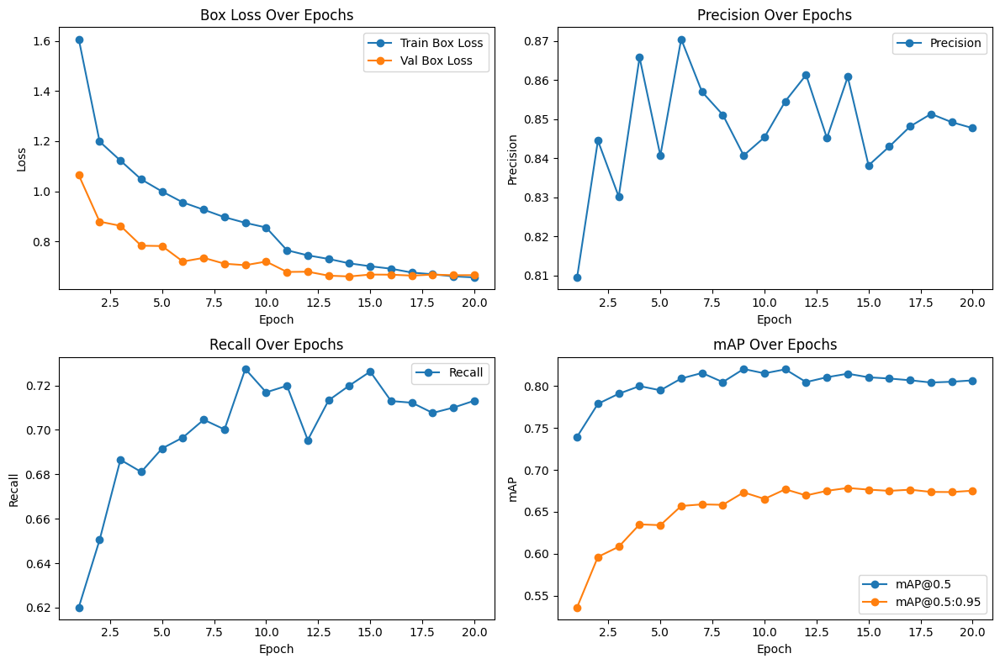

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training3/results.csv'
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()

In [1]:
#Trying SGD optimizer rather than the default AdamW Optimizer
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allData.yaml',
    epochs=20,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='full_data_training_sgd',
    augment=True,
    cos_lr=True,
    optimizer='SGD',
)

New https://pypi.org/project/ultralytics/8.3.51 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allData.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training_sgd, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, e

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\train.cache... 26910 images, 7450 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [00:00<?, ?it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004455.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004457.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004459.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004461.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004465.png: 4 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004467.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004469.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preproce


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\val.cache... 3364 images, 1147 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:00<?, ?it/s]


Plotting labels to vehicle_detection\full_data_training_sgd\labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training_sgd
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.29G      1.796      2.034      1.082         46        640: 100%|██████████| 1682/1682 [06:46<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.12it/s]

                   all       3364       8363      0.795      0.631      0.727       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.41G      1.293      1.281     0.9198         84        640: 100%|██████████| 1682/1682 [06:11<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.23it/s]


                   all       3364       8363      0.837      0.637      0.767      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.27G      1.226      1.203     0.9074         73        640: 100%|██████████| 1682/1682 [06:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.21it/s]


                   all       3364       8363      0.812      0.651      0.756      0.571

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.25G      1.147      1.126     0.8939         71        640: 100%|██████████| 1682/1682 [05:57<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]


                   all       3364       8363      0.846       0.66      0.781      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.28G      1.055      1.023      0.877        103        640: 100%|██████████| 1682/1682 [05:59<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.24it/s]

                   all       3364       8363      0.795      0.678      0.776      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.26G     0.9981     0.9575     0.8682         57        640: 100%|██████████| 1682/1682 [05:58<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]

                   all       3364       8363      0.854      0.685      0.793      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.28G     0.9552     0.9047     0.8598         69        640: 100%|██████████| 1682/1682 [05:58<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.28it/s]

                   all       3364       8363      0.831      0.694      0.798      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.29G      0.927     0.8647     0.8562         50        640: 100%|██████████| 1682/1682 [05:58<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.32it/s]

                   all       3364       8363      0.856      0.694      0.805      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.27G     0.8977     0.8293     0.8519         96        640: 100%|██████████| 1682/1682 [06:00<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]

                   all       3364       8363      0.845       0.71       0.81       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.44G     0.8755     0.7984     0.8465         73        640: 100%|██████████| 1682/1682 [06:00<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.25it/s]

                   all       3364       8363      0.836       0.72      0.815      0.672


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.18G     0.7856     0.7424     0.8468         44        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.34it/s]

                   all       3364       8363      0.852      0.717      0.813      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.19G     0.7645     0.7149     0.8434         38        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.831       0.72      0.815      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.16G     0.7438     0.6836     0.8384         50        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.865      0.701      0.805      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.15G     0.7237     0.6547     0.8359         72        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.853      0.708      0.809      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.19G     0.7108     0.6319     0.8325         63        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.858      0.706       0.81      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.17G     0.6989     0.6103     0.8314         36        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.849      0.719      0.811       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.15G     0.6816     0.5926     0.8282         35        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.845      0.718      0.809      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.16G      0.671     0.5732     0.8266         38        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.43it/s]

                   all       3364       8363      0.849      0.716      0.806      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.15G     0.6621     0.5622      0.825         28        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.859      0.708      0.804      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.17G     0.6561     0.5546     0.8253         37        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.852      0.713      0.803      0.676



20 epochs completed in 2.154 hours.
Optimizer stripped from vehicle_detection\full_data_training_sgd\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training_sgd\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training_sgd\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:39<00:00,  2.67it/s]


                   all       3364       8363      0.868      0.704       0.81      0.652
               vehicle       1855       4070       0.92      0.877      0.929      0.798
        light_instance       1929       4293      0.816       0.53      0.691      0.507
Speed: 0.3ms preprocess, 6.6ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to vehicle_detection\full_data_training_sgd


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000223AD0C11E0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

   epoch     time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   436.44         1.79592         2.03370         1.08232   
1      2   833.43         1.29283         1.28131         0.91980   
2      3  1221.15         1.22648         1.20305         0.90737   
3      4  1604.11         1.14665         1.12592         0.89393   
4      5  1989.08         1.05509         1.02342         0.87701   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.79547            0.63053           0.72670   
1               0.83668            0.63713           0.76665   
2               0.81207            0.65103           0.75598   
3               0.84554            0.65971           0.78063   
4               0.79453            0.67779           0.77641   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.49047       1.15009       1.67208       0.87206  0.070018   
1              0.54523       1.00414       2

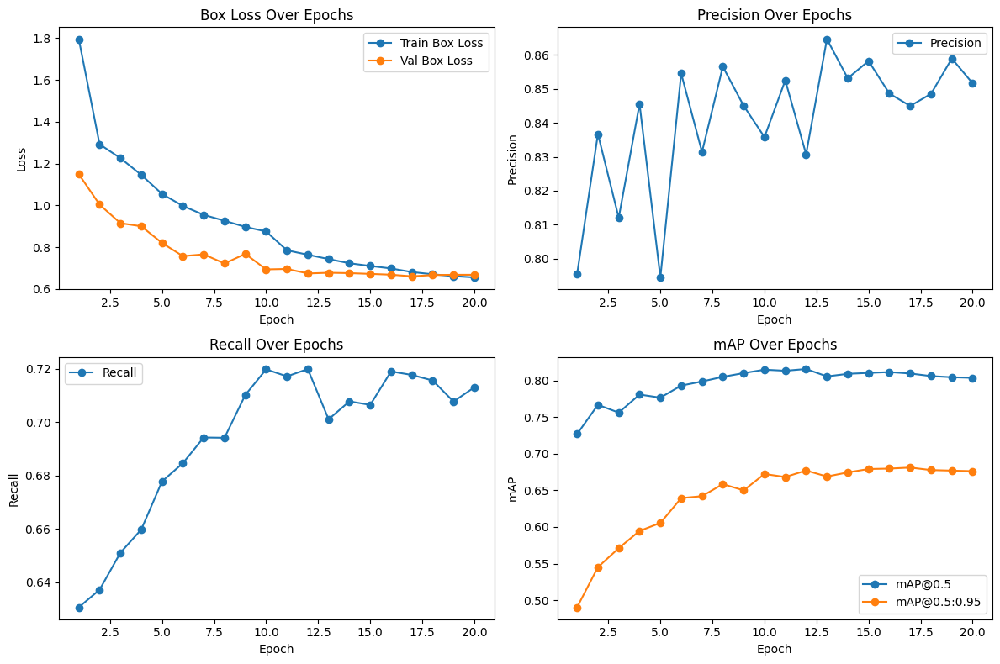

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_sgd/results.csv'
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()


In [1]:
#Trying no cosine learning rate and lower learning rate
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allData.yaml',
    epochs=20,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='full_data_training_sgd2',
    augment=True,
    optimizer='SGD',
    lr0=0.001,
)

New https://pypi.org/project/ultralytics/8.3.52 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allData.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training_sgd2, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False,

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\train.cache... 26910 images, 7450 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [00:00<?, ?it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004455.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004457.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004459.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004461.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004465.png: 4 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004467.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004469.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preproce


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\val.cache... 3364 images, 1147 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:00<?, ?it/s]


Plotting labels to vehicle_detection\full_data_training_sgd2\labels.jpg... 
optimizer: SGD(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training_sgd2
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.29G      2.276       2.83      1.256         46        640: 100%|██████████| 1682/1682 [06:15<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]


                   all       3364       8363      0.642      0.478      0.538      0.203

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.42G      1.447      1.538     0.9582         84        640: 100%|██████████| 1682/1682 [06:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]


                   all       3364       8363      0.738      0.568      0.675      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.28G      1.254       1.31     0.9138         73        640: 100%|██████████| 1682/1682 [06:05<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:31<00:00,  3.36it/s]


                   all       3364       8363        0.8      0.628      0.739      0.551

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.24G      1.146      1.183     0.8922         71        640: 100%|██████████| 1682/1682 [06:24<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  3.93it/s]


                   all       3364       8363       0.83       0.64      0.759      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.28G      1.066      1.089     0.8781        103        640: 100%|██████████| 1682/1682 [06:17<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.81it/s]


                   all       3364       8363      0.818      0.664      0.779      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.26G      1.017      1.021     0.8707         57        640: 100%|██████████| 1682/1682 [06:10<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:36<00:00,  2.92it/s]


                   all       3364       8363      0.854      0.659      0.783      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.28G      0.983     0.9759     0.8635         69        640: 100%|██████████| 1682/1682 [06:30<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.80it/s]


                   all       3364       8363      0.831      0.692      0.798       0.62

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.29G     0.9601     0.9361     0.8607         50        640: 100%|██████████| 1682/1682 [06:29<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.62it/s]


                   all       3364       8363      0.865      0.691      0.804      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.27G       0.94     0.9086     0.8585         96        640: 100%|██████████| 1682/1682 [06:31<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.79it/s]

                   all       3364       8363      0.824      0.713      0.809      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.44G     0.9234     0.8832     0.8541         73        640: 100%|██████████| 1682/1682 [06:48<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.69it/s]


                   all       3364       8363      0.838      0.699      0.805      0.631
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.18G     0.8266     0.8194     0.8537         44        640: 100%|██████████| 1682/1682 [06:16<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.00it/s]


                   all       3364       8363      0.832      0.704      0.804      0.643

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.19G     0.8079     0.7967     0.8511         38        640: 100%|██████████| 1682/1682 [05:57<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.31it/s]

                   all       3364       8363      0.852      0.698      0.805      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.16G     0.7964     0.7768     0.8475         50        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]

                   all       3364       8363      0.845      0.711      0.815      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.15G     0.7826     0.7565     0.8459         72        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.30it/s]

                   all       3364       8363      0.839      0.713       0.81      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.19G     0.7757      0.742     0.8438         63        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.842      0.708      0.805      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.17G     0.7711     0.7276     0.8437         36        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.76it/s]

                   all       3364       8363       0.84      0.712      0.806      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.15G     0.7552     0.7158     0.8411         35        640: 100%|██████████| 1682/1682 [06:05<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.07it/s]

                   all       3364       8363      0.842      0.706      0.802      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.16G     0.7477     0.7017     0.8403         38        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.844      0.705      0.804       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.15G     0.7402      0.692     0.8385         28        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.27it/s]

                   all       3364       8363       0.84      0.716      0.808      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.18G     0.7329     0.6819     0.8388         37        640: 100%|██████████| 1682/1682 [05:51<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.28it/s]

                   all       3364       8363      0.838      0.718      0.809      0.655



20 epochs completed in 2.226 hours.
Optimizer stripped from vehicle_detection\full_data_training_sgd2\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training_sgd2\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training_sgd2\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:39<00:00,  2.67it/s]


                   all       3364       8363      0.847      0.704      0.807      0.641
               vehicle       1855       4070      0.903      0.867      0.919      0.793
        light_instance       1929       4293      0.792       0.54      0.696      0.489
Speed: 0.3ms preprocess, 6.5ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to vehicle_detection\full_data_training_sgd2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000278571D7340>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   404.544         2.27551         2.83031         1.25578   
1      2   790.899         1.44693         1.53849         0.95818   
2      3  1189.110         1.25441         1.31017         0.91382   
3      4  1601.400         1.14596         1.18269         0.89225   
4      5  2007.150         1.06618         1.08943         0.87810   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.64246            0.47829           0.53811   
1               0.73782            0.56822           0.67477   
2               0.79985            0.62774           0.73861   
3               0.82985            0.63964           0.75860   
4               0.81849            0.66417           0.77872   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.20339       2.09948       3.13954       1.15667  0.067020   
1              0.47278       1.08745  

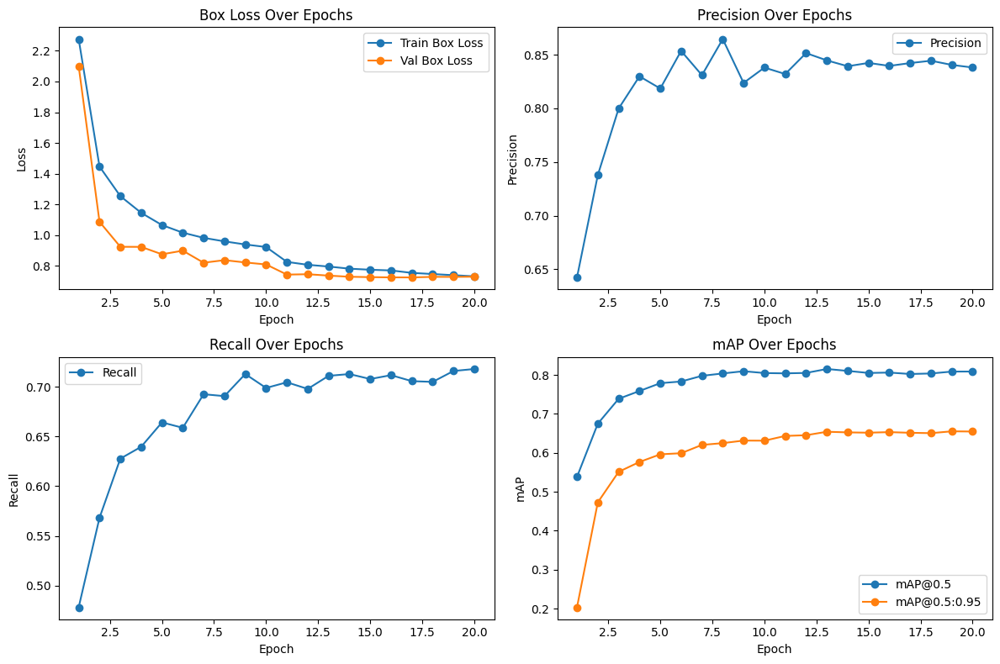

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_sgd2/results.csv'
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()


In [1]:
#Removing the hyperparameter tuning from the previous tries as the first parameters used was the best, and added dropout rate to reduce overfitting and improve the models learning. Also increased the number of epochs to see if the model will learn any more from the initial 20 epochs
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allData.yaml',
    epochs=100,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='full_data_training_with_dropout',
    dropout=0.2
)


New https://pypi.org/project/ultralytics/8.3.52 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allData.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training_with_dropout2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.2, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\train.cache... 26910 images, 7450 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [00:00<?, ?it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004455.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004457.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004459.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004461.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004465.png: 4 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004467.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data\images\train\004469.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preproce


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data\labels\val.cache... 3364 images, 1147 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:00<?, ?it/s]


Plotting labels to vehicle_detection\full_data_training_with_dropout2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training_with_dropout2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.29G      1.832      2.559      1.097         46        640: 100%|██████████| 1682/1682 [06:20<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.21it/s]


                   all       3364       8363      0.795      0.601      0.705      0.488

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.43G      1.294      1.354     0.9195         84        640: 100%|██████████| 1682/1682 [06:04<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]


                   all       3364       8363      0.835      0.641      0.763      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.28G      1.231      1.197     0.9075         73        640: 100%|██████████| 1682/1682 [05:59<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.31it/s]

                   all       3364       8363      0.826      0.653      0.768       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.24G      1.152      1.124     0.8948         71        640: 100%|██████████| 1682/1682 [05:59<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.16it/s]

                   all       3364       8363      0.828      0.667      0.772      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.28G      1.066      1.034     0.8786        103        640: 100%|██████████| 1682/1682 [06:00<00:00,  4.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.21it/s]

                   all       3364       8363      0.835      0.692      0.792      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.26G      1.008     0.9693       0.87         57        640: 100%|██████████| 1682/1682 [06:00<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.27it/s]

                   all       3364       8363      0.861      0.686      0.795      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.28G     0.9747     0.9262      0.863         69        640: 100%|██████████| 1682/1682 [06:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]

                   all       3364       8363      0.834      0.699      0.801      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.29G     0.9501     0.8857     0.8597         50        640: 100%|██████████| 1682/1682 [06:04<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.28it/s]

                   all       3364       8363       0.86      0.699      0.801      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.27G     0.9275     0.8623     0.8561         96        640: 100%|██████████| 1682/1682 [06:03<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.21it/s]

                   all       3364       8363      0.862      0.702      0.816       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.44G     0.9149     0.8394     0.8529         73        640: 100%|██████████| 1682/1682 [06:03<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.19it/s]

                   all       3364       8363      0.828      0.727      0.817      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.33G     0.8956     0.8177     0.8501         77        640: 100%|██████████| 1682/1682 [06:02<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.17it/s]

                   all       3364       8363      0.847      0.706      0.809      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.28G     0.8873     0.8077     0.8491         55        640: 100%|██████████| 1682/1682 [06:03<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.831      0.725      0.815      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.26G     0.8769     0.7941     0.8487         74        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.30it/s]

                   all       3364       8363      0.867      0.707      0.812      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.35G     0.8641     0.7704      0.847         35        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.49it/s]

                   all       3364       8363       0.85      0.722      0.818      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.32G      0.856     0.7623     0.8438         54        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363       0.84      0.735      0.824      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.31G     0.8504     0.7515     0.8435         67        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.42it/s]

                   all       3364       8363      0.843      0.714      0.814      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.38G     0.8431     0.7443     0.8416         74        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.43it/s]

                   all       3364       8363      0.869      0.701      0.813       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.21G     0.8379     0.7363     0.8412         71        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.47it/s]

                   all       3364       8363      0.844      0.721      0.819      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.39G     0.8289     0.7277     0.8404         56        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.864      0.716      0.816      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       2.2G     0.8277     0.7208     0.8402         70        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.855       0.72      0.817      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.32G     0.8202     0.7092     0.8385         64        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.43it/s]

                   all       3364       8363      0.859      0.729      0.822      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.26G     0.8199     0.7089     0.8373         48        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.46it/s]

                   all       3364       8363      0.864      0.723      0.819      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.28G     0.8126     0.7033     0.8376         60        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.31it/s]

                   all       3364       8363      0.864      0.717      0.818      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.27G     0.8078     0.6957     0.8372         56        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.26it/s]

                   all       3364       8363      0.851      0.726       0.82      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.21G     0.8071     0.6894     0.8365         35        640: 100%|██████████| 1682/1682 [06:07<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  3.99it/s]

                   all       3364       8363      0.843      0.728      0.817      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.32G     0.8007     0.6813     0.8348         60        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.34it/s]

                   all       3364       8363      0.855      0.721      0.816      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.26G     0.7985     0.6826     0.8348         65        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.862      0.718      0.814      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.38G      0.795     0.6732     0.8338         98        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.31it/s]

                   all       3364       8363      0.855      0.719      0.812      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.23G     0.7931     0.6667     0.8343         64        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.845      0.722      0.812      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.28G     0.7861     0.6653     0.8335         72        640: 100%|██████████| 1682/1682 [05:57<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.24it/s]

                   all       3364       8363      0.852      0.719       0.81      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.22G     0.7837     0.6582     0.8327         63        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.857      0.719      0.809      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.28G     0.7785     0.6529     0.8326         57        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.854      0.721      0.809      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.47G     0.7772     0.6517     0.8317         36        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.35it/s]

                   all       3364       8363      0.856      0.722      0.809       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       2.3G     0.7774     0.6469     0.8317         54        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.853      0.723      0.809      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.28G     0.7707     0.6404     0.8312         58        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.853      0.723       0.81      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.38G     0.7705      0.643     0.8311         50        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.853      0.722       0.81      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.17G      0.767     0.6335     0.8308         61        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.32it/s]

                   all       3364       8363      0.853      0.723      0.811      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       2.2G     0.7601     0.6311     0.8303         38        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.852      0.723      0.811      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.39G     0.7632      0.632     0.8306         62        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.47it/s]

                   all       3364       8363      0.857      0.721      0.811      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       2.2G     0.7561     0.6231      0.829         56        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.43it/s]

                   all       3364       8363       0.85      0.724      0.811      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.27G     0.7544     0.6185     0.8289         61        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363       0.85      0.725      0.811      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.31G     0.7543     0.6168     0.8291         48        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.32it/s]

                   all       3364       8363      0.849      0.724      0.811      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.27G     0.7482     0.6102     0.8272         52        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.35it/s]

                   all       3364       8363      0.857      0.719      0.811      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.39G     0.7469     0.6087     0.8282         71        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.855      0.722      0.812      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.28G      0.743     0.6038     0.8275         87        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.42it/s]

                   all       3364       8363      0.854      0.723      0.812      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.39G     0.7396     0.6027     0.8273         42        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.855      0.722      0.812      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.29G     0.7355     0.5965     0.8267         55        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.858       0.72      0.812      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.21G     0.7385     0.5971     0.8264         41        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.854      0.722      0.812      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.39G     0.7324     0.5897     0.8266         56        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.852      0.723      0.811      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.42G      0.735      0.592     0.8259         71        640: 100%|██████████| 1682/1682 [06:03<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.853      0.723      0.811      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.39G     0.7342     0.5896     0.8252         75        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.852      0.724      0.811      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.43G     0.7276     0.5824     0.8251         39        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.851      0.723       0.81      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.37G     0.7253       0.58     0.8257         50        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.848      0.725       0.81      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.27G     0.7243     0.5761      0.824         55        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.851      0.724       0.81      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.26G     0.7215     0.5735     0.8245         67        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.851      0.723       0.81      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.28G     0.7194     0.5729     0.8241         70        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.34it/s]

                   all       3364       8363      0.853      0.721       0.81      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.33G     0.7152     0.5697     0.8231        105        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:25<00:00,  4.14it/s]

                   all       3364       8363      0.851      0.721       0.81      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.17G     0.7183     0.5678     0.8234         47        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.852       0.72       0.81      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.28G     0.7144     0.5644     0.8233         64        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363       0.85      0.721       0.81      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.39G     0.7103     0.5631     0.8239         28        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.31it/s]

                   all       3364       8363      0.851       0.72      0.809      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.33G      0.708      0.562     0.8231         92        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363       0.85      0.722      0.808      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       2.2G     0.7056     0.5553     0.8219         60        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.849      0.721      0.808      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.28G     0.7058     0.5555     0.8225         83        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.852       0.72      0.808      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.38G     0.7013     0.5537     0.8205         96        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.859      0.717      0.807      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.32G     0.6963      0.545     0.8211         63        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.33it/s]

                   all       3364       8363      0.851      0.719      0.807      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.41G      0.696     0.5422     0.8203         51        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.852       0.72      0.807      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.39G     0.6953     0.5385     0.8205         44        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.852       0.72      0.807      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.38G     0.6933     0.5417     0.8199         86        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.852      0.721      0.807      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100       2.3G     0.6958     0.5393     0.8214         83        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.853      0.719      0.806      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.27G      0.691     0.5344     0.8204         75        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363       0.85      0.721      0.807      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.31G     0.6893     0.5338     0.8194         61        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.853      0.719      0.806      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.39G     0.6827     0.5268     0.8188         65        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.851      0.722      0.805      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.28G     0.6837     0.5275     0.8196         59        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363       0.85      0.723      0.805      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.29G      0.681     0.5223     0.8184         56        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.851      0.723      0.805      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.38G     0.6804     0.5235     0.8191         49        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363       0.85      0.723      0.805      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.22G     0.6759     0.5157     0.8177         57        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.852      0.721      0.805      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.19G     0.6749     0.5155     0.8179         59        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363       0.85      0.723      0.804      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.29G     0.6751      0.512     0.8183         85        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.849      0.722      0.804      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.32G     0.6689     0.5104     0.8169         88        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.44it/s]

                   all       3364       8363      0.848      0.723      0.804      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.22G     0.6678     0.5089     0.8173         85        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.42it/s]

                   all       3364       8363      0.848      0.722      0.804      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.27G     0.6644     0.5052     0.8174         52        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.43it/s]

                   all       3364       8363      0.851      0.721      0.803       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.37G     0.6636     0.5015     0.8164         73        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.851      0.721      0.803       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.23G     0.6632     0.4973     0.8165         75        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.851       0.72      0.803       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.39G      0.657     0.4942     0.8154         98        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.853      0.719      0.802       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.32G     0.6527     0.4889     0.8148        100        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.852      0.719      0.802      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.28G     0.6497     0.4857     0.8144         56        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363       0.85       0.72      0.802      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.26G       0.65     0.4853     0.8143         66        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.37it/s]

                   all       3364       8363      0.852      0.719      0.802      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.19G     0.6453     0.4801      0.814         51        640: 100%|██████████| 1682/1682 [05:56<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.40it/s]

                   all       3364       8363      0.851      0.719      0.802      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.42G     0.6431     0.4788     0.8134        112        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.854      0.718      0.802      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       2.3G     0.6409     0.4756     0.8132         61        640: 100%|██████████| 1682/1682 [05:55<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.854      0.717      0.801      0.679


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.15G     0.5914     0.4408     0.8125         29        640: 100%|██████████| 1682/1682 [05:49<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363       0.86      0.714      0.801      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.15G     0.5887     0.4348     0.8121         36        640: 100%|██████████| 1682/1682 [05:51<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.35it/s]

                   all       3364       8363       0.86      0.714      0.801      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.15G     0.5826     0.4295     0.8121         30        640: 100%|██████████| 1682/1682 [05:51<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.41it/s]

                   all       3364       8363      0.861      0.714        0.8      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.14G     0.5795     0.4279     0.8115         37        640: 100%|██████████| 1682/1682 [05:51<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.39it/s]

                   all       3364       8363      0.861      0.715        0.8      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.15G     0.5772     0.4226     0.8103         16        640: 100%|██████████| 1682/1682 [05:51<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.38it/s]

                   all       3364       8363      0.861      0.714      0.799      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.17G     0.5738     0.4182      0.811         29        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.35it/s]

                   all       3364       8363      0.862      0.713      0.799      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.15G     0.5711     0.4153     0.8093         22        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.35it/s]

                   all       3364       8363      0.861      0.713      0.798      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.18G     0.5662     0.4087     0.8097         29        640: 100%|██████████| 1682/1682 [05:52<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:23<00:00,  4.43it/s]

                   all       3364       8363      0.859      0.714      0.797      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.17G     0.5641     0.4066     0.8083         35        640: 100%|██████████| 1682/1682 [05:53<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.34it/s]

                   all       3364       8363      0.856      0.714      0.797      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.19G     0.5609     0.4039     0.8078         23        640: 100%|██████████| 1682/1682 [05:54<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:24<00:00,  4.36it/s]

                   all       3364       8363      0.857      0.713      0.797      0.675



100 epochs completed in 10.601 hours.
Optimizer stripped from vehicle_detection\full_data_training_with_dropout2\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training_with_dropout2\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training_with_dropout2\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:26<00:00,  4.07it/s]


                   all       3364       8363      0.859      0.729      0.823      0.688
               vehicle       1855       4070      0.928      0.878      0.931      0.847
        light_instance       1929       4293      0.791      0.581      0.714      0.529
Speed: 0.3ms preprocess, 2.1ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to vehicle_detection\full_data_training_with_dropout2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001EC9F417C40>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   409.936         1.83214         2.55856         1.09737   
1      2   800.240         1.29443         1.35352         0.91945   
2      3  1185.250         1.23132         1.19730         0.90749   
3      4  1571.050         1.15219         1.12444         0.89477   
4      5  1957.750         1.06613         1.03411         0.87857   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.79523            0.60051           0.70504   
1               0.83514            0.64141           0.76252   
2               0.82573            0.65276           0.76783   
3               0.82786            0.66707           0.77238   
4               0.83503            0.69198           0.79182   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.48840       1.11498       2.57717       0.87472  0.003331   
1              0.55608       1.00377  

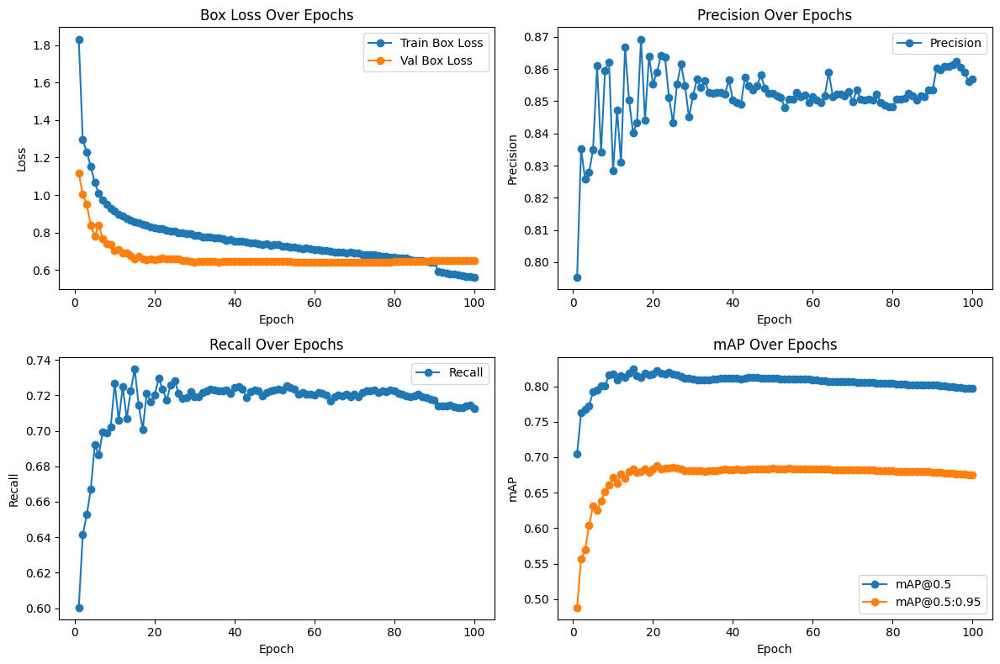

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_with_dropout2/results.csv'
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()


image 1/1 D:\Random_Projects\Tubes Viskom\preprocessed_data\images\test\020365.png: 480x640 2 vehicles, 3 light_instances, 10.0ms
Speed: 2.0ms preprocess, 10.0ms inference, 2.6ms postprocess per image at shape (1, 3, 480, 640)
Original Image:


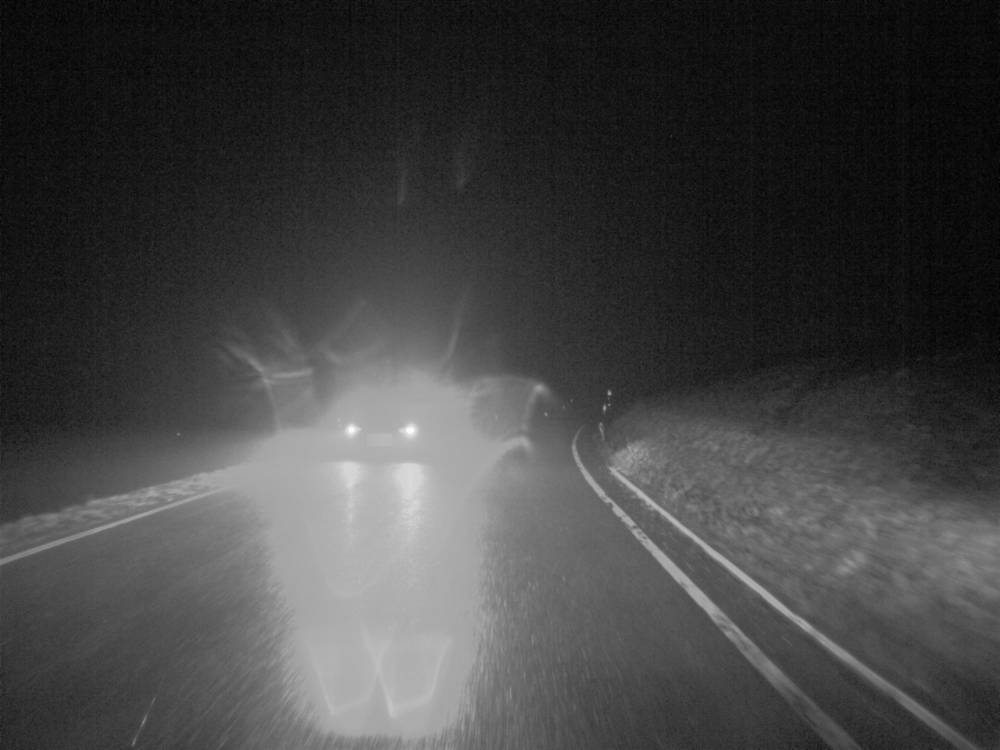

Object Detection Result:


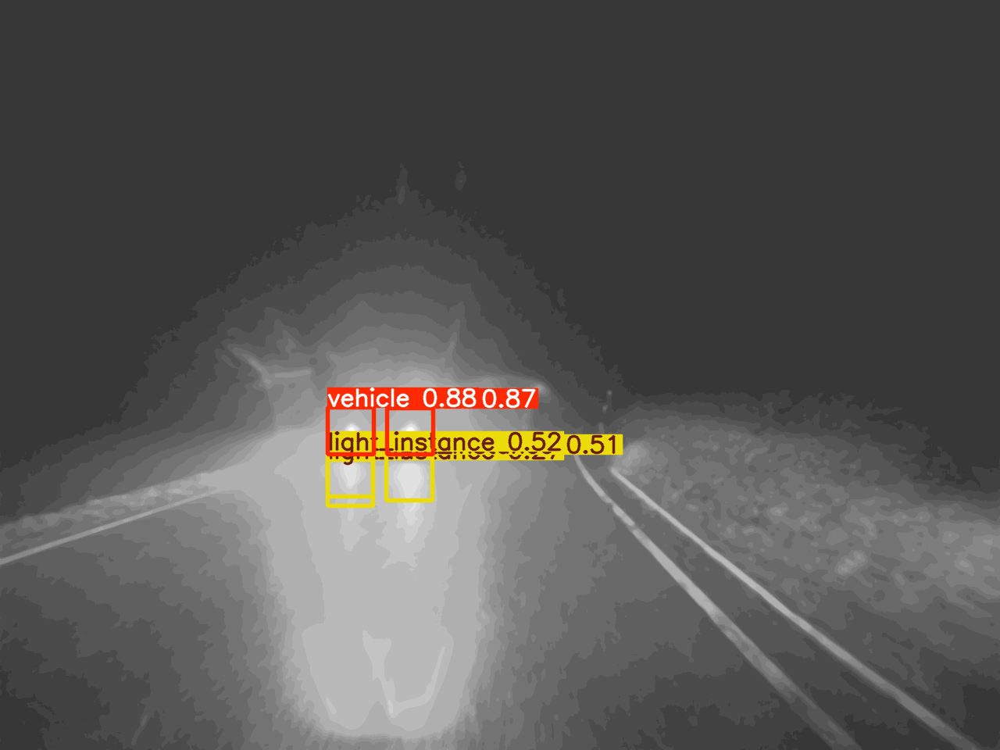

In [16]:
from ultralytics import YOLO
from IPython.display import display
from PIL import Image
import cv2

#Testing out an image from test dataset
#Load the trained model with the best weights
model = YOLO('D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_with_dropout2/weights/best.pt')

#Paths to the original and preprocessed test images
original_image_path = 'D:\\Random_Projects\\Tubes Viskom\\all_data_dataset\\images\\test\\020365.png'
preprocessed_image_path = 'D:\\Random_Projects\\Tubes Viskom\\preprocessed_data\\images\\test\\020365.png'
results = model(preprocessed_image_path)#Test the test image

#Original Image
original_image = cv2.imread(original_image_path)
print("Original Image:")
display(Image.fromarray(original_image))

#Object detected image
for result in results:
    result_image = result.plot()
    print("Object Detection Result:")
    display(Image.fromarray(result_image))

### Trying out training the data on Fathan's Preprocessing

In [1]:
#2 Object detection (Vehicle and Light instance)
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allDataFathan.yaml',
    epochs=21,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='full_data_training_fathan_2objects',
)

New https://pypi.org/project/ultralytics/8.3.52 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allDataFathan.yaml, epochs=21, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training_fathan_2objects, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, 

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\train... 26910 images, 7450 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [04:20<00:00, 103.26it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004453.png: 7 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004455.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004457.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004459.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004461.png: 3 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004465.png: 4 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004467.png: 2 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\004469.png: 2 duplicate labels removed


train: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\train.cache


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\val... 3364 images, 1147 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:35<00:00, 95.93it/s] 


val: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\val.cache
Plotting labels to vehicle_detection\full_data_training_fathan_2objects\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training_fathan_2objects
Starting training for 21 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/21      2.34G      1.744      2.114      1.051         46        640: 100%|██████████| 1682/1682 [06:56<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.16it/s]


                   all       3364       8363      0.739      0.567      0.684      0.486

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/21       2.5G      1.318       1.28     0.9227         84        640: 100%|██████████| 1682/1682 [06:44<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.24it/s]


                   all       3364       8363      0.852      0.613      0.756       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/21      2.28G      1.229      1.175     0.9045         73        640: 100%|██████████| 1682/1682 [06:51<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.19it/s]


                   all       3364       8363      0.799       0.66      0.768      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/21      2.25G      1.176      1.111     0.8946         71        640: 100%|██████████| 1682/1682 [06:38<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.16it/s]


                   all       3364       8363      0.852      0.658      0.776       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/21      2.29G      1.114      1.046     0.8831        103        640: 100%|██████████| 1682/1682 [06:37<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.21it/s]


                   all       3364       8363      0.847      0.695      0.798      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/21      2.27G      1.074     0.9886     0.8771         57        640: 100%|██████████| 1682/1682 [06:37<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.18it/s]


                   all       3364       8363      0.846      0.687      0.804      0.641

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/21      2.29G      1.034     0.9506     0.8687         69        640: 100%|██████████| 1682/1682 [06:37<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.21it/s]


                   all       3364       8363      0.849      0.703      0.807      0.632

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/21       2.3G      1.023     0.9218     0.8675         50        640: 100%|██████████| 1682/1682 [06:39<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.18it/s]


                   all       3364       8363      0.875      0.697      0.809      0.639

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/21      2.28G     0.9946     0.8909     0.8638         96        640: 100%|██████████| 1682/1682 [06:38<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.22it/s]


                   all       3364       8363      0.863        0.7      0.804      0.634

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/21      2.45G     0.9747     0.8669     0.8593         73        640: 100%|██████████| 1682/1682 [06:38<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.20it/s]


                   all       3364       8363      0.842      0.724      0.812      0.642

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/21      2.34G     0.9499     0.8427     0.8555         77        640: 100%|██████████| 1682/1682 [06:40<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.19it/s]

                   all       3364       8363      0.864      0.702      0.808      0.649


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/21       2.2G     0.8573     0.7858     0.8563         35        640: 100%|██████████| 1682/1682 [06:31<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.18it/s]


                   all       3364       8363      0.874       0.71       0.81      0.663

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/21      2.16G     0.8437     0.7676     0.8544         59        640: 100%|██████████| 1682/1682 [06:36<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.21it/s]

                   all       3364       8363      0.867      0.708      0.813       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/21      2.16G      0.834     0.7497     0.8523         71        640: 100%|██████████| 1682/1682 [06:35<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.19it/s]


                   all       3364       8363      0.856      0.718      0.819      0.675

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/21       2.2G     0.8197     0.7294     0.8492         65        640: 100%|██████████| 1682/1682 [06:36<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.19it/s]

                   all       3364       8363      0.865      0.713      0.816      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/21      2.19G     0.8062     0.7111      0.846         34        640: 100%|██████████| 1682/1682 [06:37<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:33<00:00,  3.18it/s]


                   all       3364       8363      0.863      0.715      0.809      0.669

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/21      2.16G      0.793     0.6922     0.8443         35        640: 100%|██████████| 1682/1682 [06:43<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.21it/s]

                   all       3364       8363      0.869      0.716      0.811      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/21      2.17G      0.779     0.6724      0.842         38        640: 100%|██████████| 1682/1682 [06:34<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.27it/s]

                   all       3364       8363      0.858      0.726      0.811      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/21      2.16G     0.7649     0.6589     0.8416         28        640: 100%|██████████| 1682/1682 [06:35<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.30it/s]

                   all       3364       8363      0.862      0.726      0.816      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/21      2.19G     0.7491     0.6378     0.8385         37        640: 100%|██████████| 1682/1682 [06:35<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.28it/s]

                   all       3364       8363      0.856      0.733      0.817      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/21      2.16G     0.7432     0.6294     0.8364         19        640: 100%|██████████| 1682/1682 [06:31<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.29it/s]

                   all       3364       8363      0.859      0.733      0.818       0.68



21 epochs completed in 2.542 hours.
Optimizer stripped from vehicle_detection\full_data_training_fathan_2objects\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training_fathan_2objects\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training_fathan_2objects\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:31<00:00,  3.32it/s]


                   all       3364       8363      0.857      0.734      0.818       0.68
               vehicle       1855       4070      0.933      0.882      0.934      0.849
        light_instance       1929       4293      0.781      0.586      0.702      0.512
Speed: 0.3ms preprocess, 2.1ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to vehicle_detection\full_data_training_fathan_2objects


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000025E1C410730>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   454.588         1.74352         2.11408         1.05107   
1      2   893.697         1.31755         1.27969         0.92271   
2      3  1339.480         1.22927         1.17480         0.90452   
3      4  1772.460         1.17592         1.11080         0.89465   
4      5  2204.330         1.11439         1.04571         0.88306   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.73902            0.56651           0.68412   
1               0.85242            0.61346           0.75611   
2               0.79901            0.66041           0.76806   
3               0.85195            0.65758           0.77628   
4               0.84665            0.69513           0.79772   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.48564       1.05160       2.03127       0.85262  0.000555   
1              0.53039       1.09785  

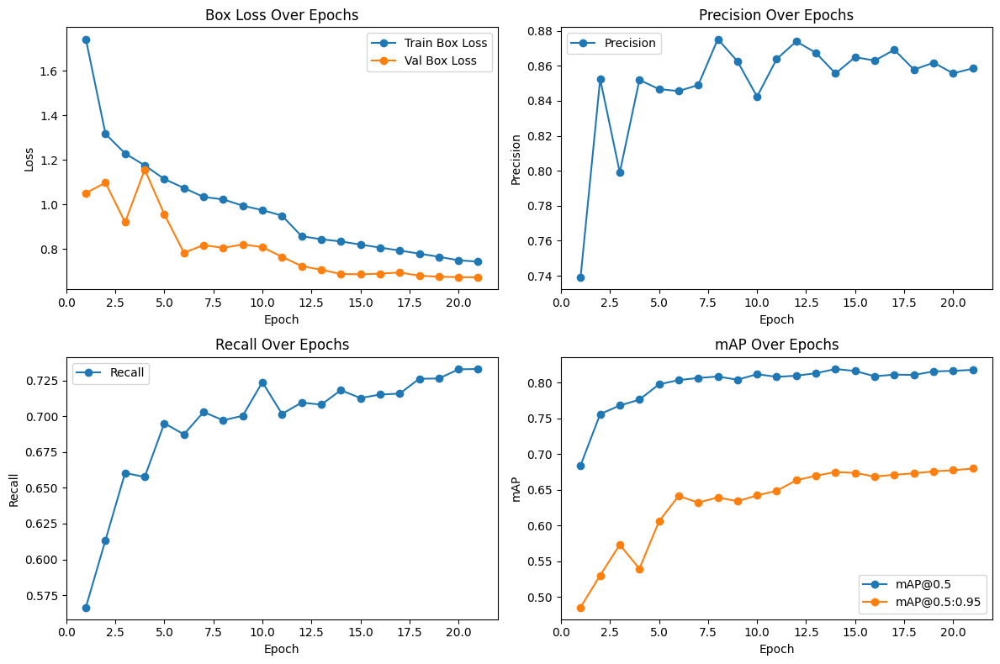

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_fathan_2objects/results.csv'
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()


image 1/1 D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\test\017204.png: 480x640 3 vehicles, 4 light_instances, 18.0ms
Speed: 5.0ms preprocess, 18.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
Original Image:


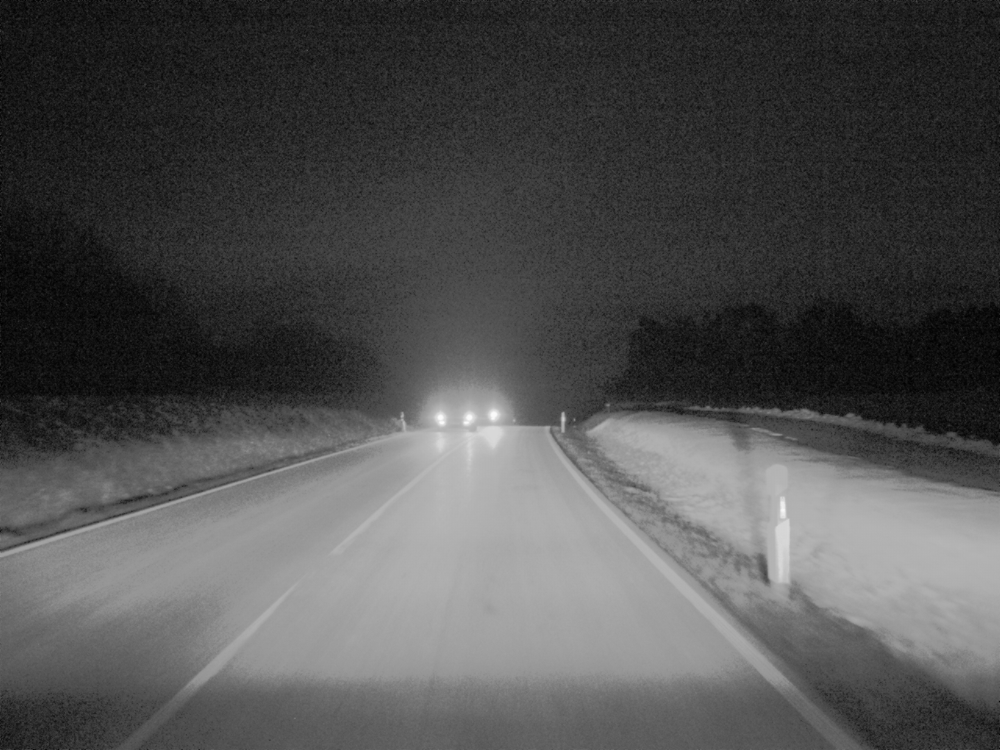

Object Detection Result:


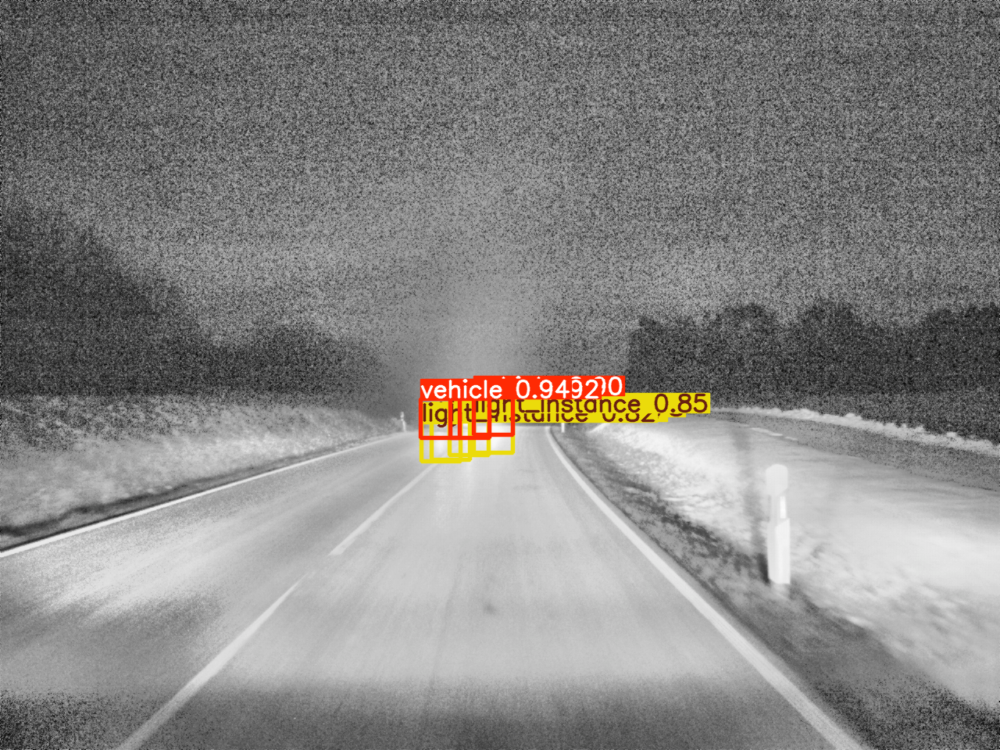

In [ ]:
from ultralytics import YOLO
from IPython.display import display
from PIL import Image
import cv2

#Testing out an image from test dataset
#Load the trained model with the best weights
model = YOLO('D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_fathan_2objects/weights/best.pt')

#Paths to the original and preprocessed test images
original_image_path = 'D:\\Random_Projects\\Tubes Viskom\\all_data_dataset\\images\\test\\017204.png'
preprocessed_image_path = 'D:\\Random_Projects\\Tubes Viskom\\preprocessed_data_Fathan\\images\\test\\017204.png'
results = model(preprocessed_image_path)#Test the test image

#Original Image
original_image = cv2.imread(original_image_path)
print("Original Image:")
display(Image.fromarray(original_image))

#Object detected image
for result in results:
    result_image = result.plot()
    print("Object Detection Result:")
    display(Image.fromarray(result_image))


### Trying out only 1 class (Vehicle only) to train the YOLOv8n Model

In [ ]:
import os
#Removing light classes on train, val, test labels
label_dirs = [
    'D:/Random_Projects/Tubes Viskom/preprocessed_data_Fathan/labels/train',
    'D:/Random_Projects/Tubes Viskom/preprocessed_data_Fathan/labels/val',
    'D:/Random_Projects/Tubes Viskom/preprocessed_data_Fathan/labels/test'
]
for label_dir in label_dirs:
    for file in os.listdir(label_dir):
        if file.endswith('.txt'):
            file_path = os.path.join(label_dir, file)
            with open(file_path, 'r') as f:
                lines = f.readlines()
            #Keep only lines with class 0 (because class 0 is vehicle)
            cleaned_lines = [line for line in lines if line.startswith('0 ')]
            with open(file_path, 'w') as f:
                f.writelines(cleaned_lines)


In [1]:
#1 Class Object detection with Fathan's Preprocessing
from ultralytics import YOLO
model = YOLO('yolov8n.pt')

#Train the model
model.train(
    data='allDataFathanOnlyVehicle.yaml',
    epochs=30,
    imgsz=640,
    batch=16,
    project='vehicle_detection',
    name='full_data_training_fathan_1object',
    dropout=0.3
)

New https://pypi.org/project/ultralytics/8.3.52 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=allDataFathanOnlyVehicle.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=vehicle_detection, name=full_data_training_fathan_1object2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.3, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, cla

train: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\train... 26910 images, 11255 backgrounds, 0 corrupt: 100%|██████████| 26910/26910 [04:23<00:00, 102.20it/s]

train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\063026.png: 1 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\110601.png: 1 duplicate labels removed
train: WARNING  D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\train\140419.png: 1 duplicate labels removed


train: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\train.cache


val: Scanning D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\val... 3364 images, 1509 backgrounds, 0 corrupt: 100%|██████████| 3364/3364 [00:33<00:00, 99.05it/s] 


val: New cache created: D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\labels\val.cache
Plotting labels to vehicle_detection\full_data_training_fathan_1object2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to vehicle_detection\full_data_training_fathan_1object2
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      2.24G      1.841      2.537      1.099         23        640: 100%|██████████| 1682/1682 [06:52<00:00,  4.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:32<00:00,  3.29it/s]


                   all       3364       4070      0.905      0.687      0.801      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      2.27G      1.312      1.125     0.9187         45        640: 100%|██████████| 1682/1682 [06:44<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.43it/s]


                   all       3364       4070      0.933      0.736      0.845      0.647

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      2.26G      1.249      1.024      0.906         46        640: 100%|██████████| 1682/1682 [06:31<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.43it/s]


                   all       3364       4070      0.789       0.67      0.762      0.562

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      2.18G       1.17     0.9689     0.8932         37        640: 100%|██████████| 1682/1682 [06:30<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.43it/s]

                   all       3364       4070      0.919      0.796      0.886        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      2.17G      1.063     0.8675     0.8718         55        640: 100%|██████████| 1682/1682 [06:33<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:31<00:00,  3.42it/s]

                   all       3364       4070      0.946      0.812      0.903      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      2.17G     0.9935     0.7975     0.8614         35        640: 100%|██████████| 1682/1682 [06:35<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:31<00:00,  3.40it/s]

                   all       3364       4070      0.932      0.817      0.905      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      2.23G     0.9522     0.7596     0.8536         44        640: 100%|██████████| 1682/1682 [06:36<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.43it/s]

                   all       3364       4070      0.965      0.821      0.911      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      2.18G     0.9246     0.7268     0.8502         28        640: 100%|██████████| 1682/1682 [06:33<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.50it/s]

                   all       3364       4070      0.947      0.838      0.912      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      2.17G     0.8929      0.692     0.8457         54        640: 100%|██████████| 1682/1682 [06:36<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.49it/s]

                   all       3364       4070      0.965      0.848      0.922      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      2.17G     0.8729     0.6728     0.8418         46        640: 100%|██████████| 1682/1682 [06:36<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.51it/s]

                   all       3364       4070      0.964      0.835       0.92      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      2.17G     0.8549     0.6529     0.8389         47        640: 100%|██████████| 1682/1682 [06:34<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.52it/s]

                   all       3364       4070      0.966      0.837      0.927      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      2.17G     0.8372     0.6369     0.8363         35        640: 100%|██████████| 1682/1682 [06:31<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:30<00:00,  3.51it/s]

                   all       3364       4070      0.959      0.844      0.924      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      2.15G     0.8216     0.6226     0.8348         34        640: 100%|██████████| 1682/1682 [06:30<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:31<00:00,  3.38it/s]

                   all       3364       4070       0.97      0.845      0.931      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      2.31G     0.8073     0.6024     0.8333         19        640: 100%|██████████| 1682/1682 [06:31<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.55it/s]

                   all       3364       4070      0.969      0.846       0.93      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      2.21G     0.7886     0.5864     0.8294         22        640: 100%|██████████| 1682/1682 [06:29<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.59it/s]

                   all       3364       4070      0.957      0.861      0.934      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      2.18G     0.7796     0.5753     0.8274         43        640: 100%|██████████| 1682/1682 [06:28<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.58it/s]

                   all       3364       4070      0.966      0.857      0.931      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      2.17G     0.7765     0.5698     0.8272         35        640: 100%|██████████| 1682/1682 [06:29<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.65it/s]

                   all       3364       4070      0.961      0.852      0.931      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      2.19G     0.7563     0.5537     0.8247         38        640: 100%|██████████| 1682/1682 [06:25<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.59it/s]

                   all       3364       4070      0.973      0.854      0.927       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      2.17G      0.744     0.5418     0.8244         27        640: 100%|██████████| 1682/1682 [06:26<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.60it/s]

                   all       3364       4070      0.972      0.846       0.93      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      2.17G     0.7347      0.534     0.8225         33        640: 100%|██████████| 1682/1682 [06:25<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.65it/s]

                   all       3364       4070      0.965      0.859      0.928      0.842


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      2.17G     0.6747     0.4953     0.8223         12        640: 100%|██████████| 1682/1682 [06:14<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.61it/s]

                   all       3364       4070      0.965      0.858      0.931      0.849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      2.15G     0.6633     0.4861     0.8217         29        640: 100%|██████████| 1682/1682 [06:16<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.61it/s]

                   all       3364       4070      0.973      0.852      0.927      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      2.13G     0.6521     0.4744     0.8201         11        640: 100%|██████████| 1682/1682 [06:17<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.69it/s]

                   all       3364       4070      0.963      0.859      0.929      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      2.15G     0.6382      0.463     0.8179         21        640: 100%|██████████| 1682/1682 [06:17<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:29<00:00,  3.61it/s]

                   all       3364       4070      0.969      0.853      0.929      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      2.18G     0.6289     0.4491     0.8149         23        640: 100%|██████████| 1682/1682 [06:18<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.66it/s]

                   all       3364       4070      0.968      0.857      0.929      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      2.13G     0.6238     0.4421     0.8146         18        640: 100%|██████████| 1682/1682 [06:18<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.67it/s]

                   all       3364       4070       0.97      0.855      0.928      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      2.17G     0.6114     0.4289     0.8136         20        640: 100%|██████████| 1682/1682 [06:18<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.67it/s]

                   all       3364       4070      0.969      0.857      0.928      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      2.13G      0.596     0.4168     0.8108         25        640: 100%|██████████| 1682/1682 [06:14<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.73it/s]

                   all       3364       4070       0.97      0.855      0.928      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      2.17G     0.5924      0.412     0.8096          8        640: 100%|██████████| 1682/1682 [06:17<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.73it/s]

                   all       3364       4070      0.969      0.857      0.931      0.858



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      2.15G     0.5802     0.4019      0.809          7        640: 100%|██████████| 1682/1682 [06:17<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:28<00:00,  3.70it/s]

                   all       3364       4070      0.972      0.855       0.93      0.858



30 epochs completed in 3.501 hours.
Optimizer stripped from vehicle_detection\full_data_training_fathan_1object2\weights\last.pt, 6.2MB
Optimizer stripped from vehicle_detection\full_data_training_fathan_1object2\weights\best.pt, 6.2MB

Validating vehicle_detection\full_data_training_fathan_1object2\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 106/106 [00:27<00:00,  3.82it/s]


                   all       3364       4070      0.969      0.858      0.931      0.858
Speed: 0.3ms preprocess, 2.1ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to vehicle_detection\full_data_training_fathan_1object2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000020716C49780>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   449.174         1.84075         2.53721         1.09947   
1      2   885.808         1.31177         1.12509         0.91872   
2      3  1308.880         1.24922         1.02435         0.90605   
3      4  1730.590         1.16992         0.96891         0.89320   
4      5  2155.610         1.06253         0.86748         0.87179   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.90510            0.68747           0.80084   
1               0.93273            0.73587           0.84489   
2               0.78917            0.66955           0.76223   
3               0.91918            0.79631           0.88572   
4               0.94567            0.81229           0.90289   

   metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
0              0.59160       0.88100       1.53278       0.78854  0.003331   
1              0.64692       0.80061  

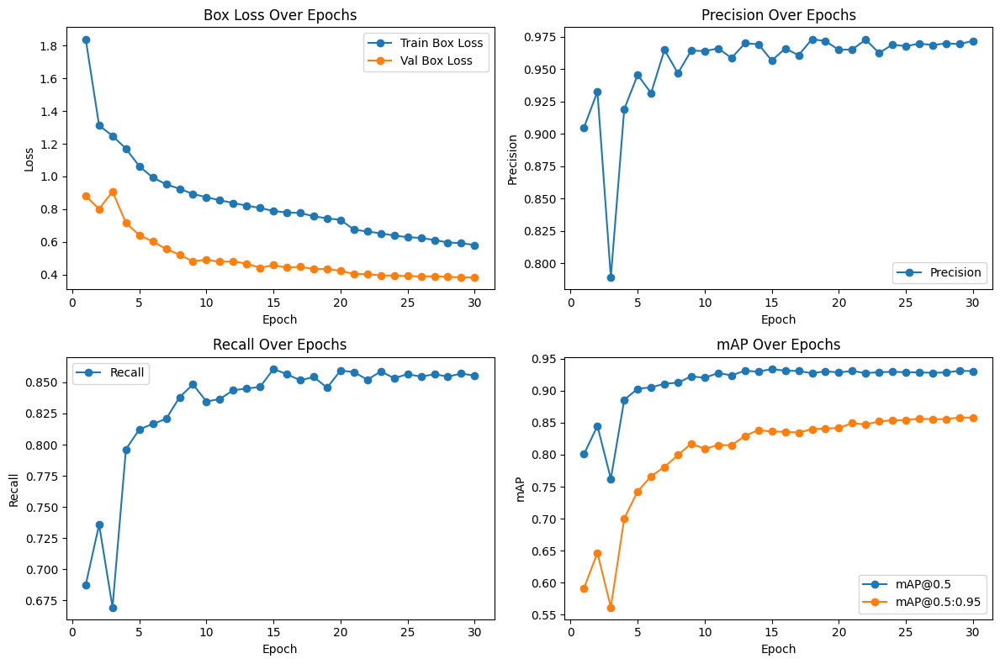

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = 'D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_fathan_1object2/results.csv'
results = pd.read_csv(results_path)
print(results.head())

#Plotting training metrics
plt.figure(figsize=(12, 8))
#Train and Val Loss
plt.subplot(2, 2, 1)
plt.plot(results['epoch'], results['train/box_loss'], label='Train Box Loss', marker='o')
plt.plot(results['epoch'], results['val/box_loss'], label='Val Box Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Box Loss Over Epochs')
plt.legend()
#Precision
plt.subplot(2, 2, 2)
plt.plot(results['epoch'], results['metrics/precision(B)'], label='Precision', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Over Epochs')
plt.legend()
#Recall
plt.subplot(2, 2, 3)
plt.plot(results['epoch'], results['metrics/recall(B)'], label='Recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Over Epochs')
plt.legend()
#mAPs
plt.subplot(2, 2, 4)
plt.plot(results['epoch'], results['metrics/mAP50(B)'], label='mAP@0.5', marker='o')
plt.plot(results['epoch'], results['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('mAP')
plt.title('mAP Over Epochs')
plt.legend()
plt.tight_layout()
plt.show()


image 1/1 D:\Random_Projects\Tubes Viskom\preprocessed_data_Fathan\images\test\017204.png: 480x640 3 vehicles, 48.2ms
Speed: 2.2ms preprocess, 48.2ms inference, 0.0ms postprocess per image at shape (1, 3, 480, 640)
Original Image:


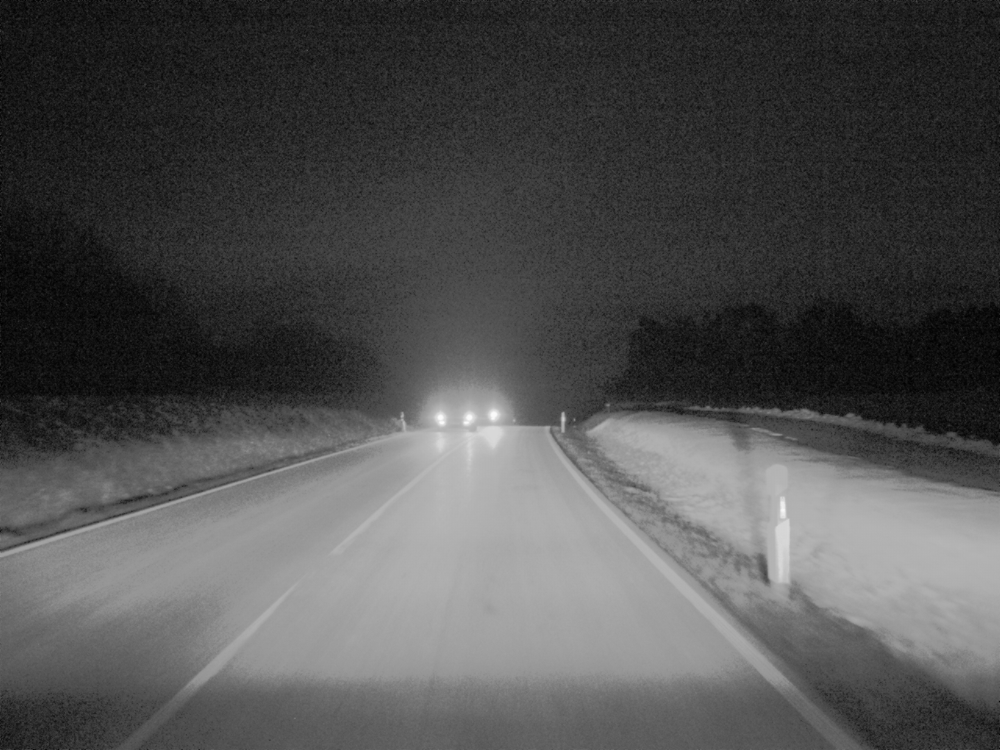

Object Detection Result:


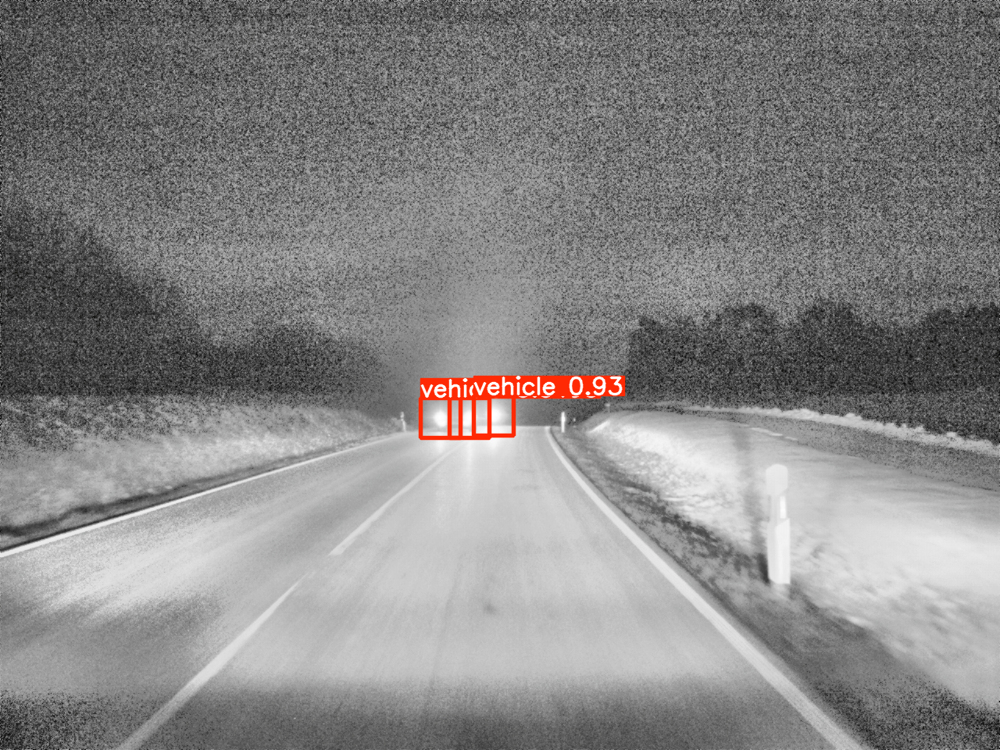

In [17]:
from ultralytics import YOLO
from IPython.display import display
from PIL import Image
import cv2

#Testing out an image from test dataset
#Load the trained model with the best weights
model = YOLO('D:/Random_Projects/Tubes Viskom/vehicle_detection/full_data_training_fathan_1object2/weights/best.pt')

#Paths to the original and preprocessed test images
original_image_path = 'D:\\Random_Projects\\Tubes Viskom\\all_data_dataset\\images\\test\\017204.png'
preprocessed_image_path = 'D:\\Random_Projects\\Tubes Viskom\\preprocessed_data_Fathan\\images\\test\\017204.png'
results = model(preprocessed_image_path)#Test the test image

#Original Image
original_image = cv2.imread(original_image_path)
print("Original Image:")
display(Image.fromarray(original_image))

#Object detected image
for result in results:
    result_image = result.plot()
    print("Object Detection Result:")
    display(Image.fromarray(result_image))
